In [1]:
# HW3 Question2 HamidrezaMafi 610399209

# === 0. KAGGLE SETUP ===
try:
    from google.colab import files
    print("Please upload your kaggle.json file")
    files.upload()
except ImportError:
    print("Not in a Colab environment. Please ensure 'kaggle.json' is in ~/.kaggle/")

# === 1. INSTALL DEPENDENCIES AND PREPARE ENVIRONMENT ===
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
print("Kaggle API configured.")

# === 2. DOWNLOAD AND UNZIP DATASET ===
print("Downloading Weizmann Horse Database...")
!kaggle datasets download -d ztaihong/weizmann-horse-database -q
!unzip -q weizmann-horse-database.zip -d ./data
print("Dataset downloaded and unzipped successfully into './data' directory.")

# === 3. CONSOLIDATED IMPORTS ===
import os
import random
import glob
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import torch.nn.functional as F
from sklearn.metrics import jaccard_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt


Please upload your kaggle.json file


Saving kaggle.json to kaggle.json
Kaggle API configured.
Dataset URL: https://www.kaggle.com/datasets/ztaihong/weizmann-horse-database
License(s): copyright-authors
Dataset downloaded and unzipped successfully into './data' directory.


In [2]:
# === HYPERPARAMETERS AND CONFIGURATION ===
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
LEARNING_RATE = 0.00008
BATCH_SIZE = 8
NUM_EPOCHS = 100
IMAGE_HEIGHT = 512
IMAGE_WIDTH = 512
PIN_MEMORY = True
LOAD_MODEL = False
RANDOM_SEED = 15

# Define Paths
DATA_DIR = '/content/data/weizmann_horse_db'
IMAGE_DIR = os.path.join(DATA_DIR, 'horse')
MASK_DIR = os.path.join(DATA_DIR, 'mask')
CHECKPOINT_PATH = "best_model_checkpoint.pth.tar"

# === DATA PREPARATION ===

image_paths = sorted(glob.glob(os.path.join(IMAGE_DIR, '*.png')))
mask_paths = sorted(glob.glob(os.path.join(MASK_DIR, '*.png')))

print(f"Found {len(image_paths)} images and {len(mask_paths)} masks.")
assert len(image_paths) == len(mask_paths), "Mismatch between image and mask counts!"

# Train/Val Split (80/20)
train_imgs, val_imgs, train_masks, val_masks = train_test_split(
    image_paths, mask_paths, test_size=0.2, random_state=RANDOM_SEED
)
print(f"Training samples: {len(train_imgs)}, Validation samples: {len(val_imgs)}")

# === DATASET CLASS ===
class HorseDataset(Dataset):
    def __init__(self, image_paths, mask_paths, image_transform=None, mask_transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.image_transform = image_transform
        self.mask_transform = mask_transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):

        image = Image.open(self.image_paths[idx]).convert("RGB").copy()
        mask = Image.open(self.mask_paths[idx]).convert("L").copy()

        if self.image_transform and self.mask_transform:
            seed = np.random.randint(2147423647)
            torch.manual_seed(seed)
            image = self.image_transform(image)
            torch.manual_seed(seed)
            mask = self.mask_transform(mask)
        else:
            image = transforms.ToTensor()(image)
            mask = transforms.ToTensor()(mask)

        # Binarize mask (ensure only 0 or 1)
        mask = (mask > 0.0001).float()
        return image, mask

# === TRANSFORMS AND DATALOADERS ===
train_image_transform = transforms.Compose([
    transforms.Resize((IMAGE_HEIGHT, IMAGE_WIDTH)),
    transforms.ToTensor(),
])

train_mask_transform = transforms.Compose([
    transforms.Resize((IMAGE_HEIGHT, IMAGE_WIDTH)),
    transforms.ToTensor(),
])

val_image_transform = transforms.Compose([
    transforms.Resize((IMAGE_HEIGHT, IMAGE_WIDTH)),
    transforms.ToTensor(),
])

val_mask_transform = transforms.Compose([
    transforms.Resize((IMAGE_HEIGHT, IMAGE_WIDTH)),
    transforms.ToTensor(),
])

# Create Datasets
train_dataset = HorseDataset(
    train_imgs, train_masks,
    image_transform=train_image_transform,
    mask_transform=train_mask_transform
)

val_dataset = HorseDataset(
    val_imgs, val_masks,
    image_transform=val_image_transform,
    mask_transform=val_mask_transform
)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)


Found 327 images and 327 masks.
Training samples: 261, Validation samples: 66


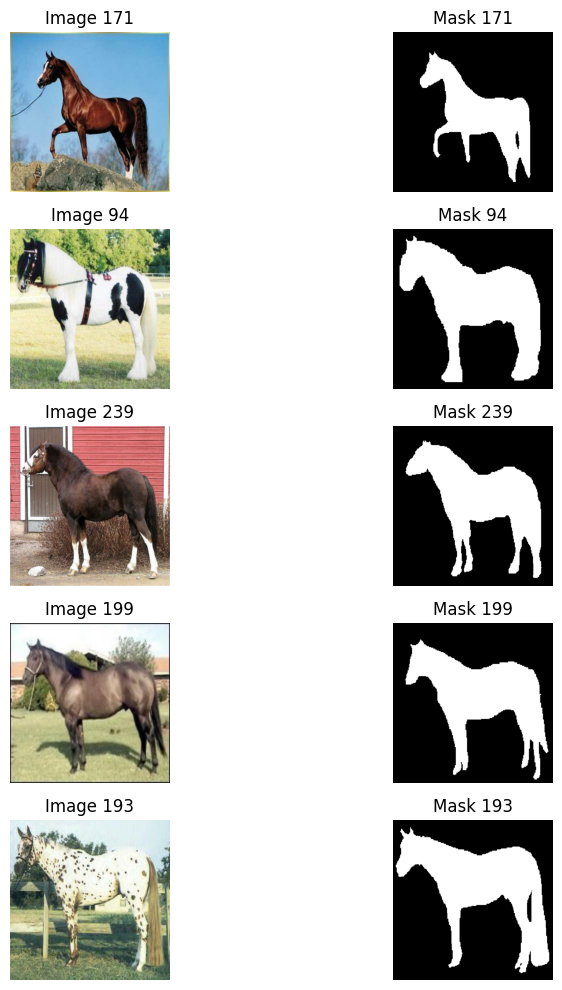

In [3]:
# === VISUALIZE A DATA SAMPLE ===
num_samples = 5
random_indices = random.sample(range(len(train_dataset)), num_samples)

plt.figure(figsize=(10, num_samples * 2))

for i, idx in enumerate(random_indices):
    image, mask = train_dataset[idx]

    plt.subplot(num_samples, 2, 2*i + 1)
    plt.imshow(image.permute(1, 2, 0))
    plt.title(f"Image {idx}")
    plt.axis('off')

    plt.subplot(num_samples, 2, 2*i + 2)
    plt.imshow(mask.squeeze(), cmap='gray')
    plt.title(f"Mask {idx}")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [4]:
# === U-NET MODEL DEFINITION ===
class UNet(nn.Module):
    def __init__(self, in_channels, out_channels, k):
        super(UNet, self).__init__()

        self.enc1 = self._conv_block(in_channels, k)
        self.enc2 = self._conv_block(k, 2 * k)
        self.enc3 = self._conv_block(2 * k, 4 * k)
        self.bottleneck = self._conv_block(4 * k, 8 * k, dropout=True)

        self.up1 = nn.ConvTranspose2d(8 * k, 4 * k, kernel_size=2, stride=2)
        self.up2 = nn.ConvTranspose2d(4 * k, 2 * k, kernel_size=2, stride=2)
        self.up3 = nn.ConvTranspose2d(2 * k, k, kernel_size=2, stride=2)

        self.dec1 = self._conv_block(8 * k, 4 * k, dropout=True)
        self.dec2 = self._conv_block(4 * k, 2 * k, dropout=True)
        self.dec3 = self._conv_block(2 * k, k, dropout=True)

        self.out = nn.Conv2d(k, out_channels, kernel_size=1)

    def _conv_block(self, in_ch, out_ch, dropout=False):
        layers = [
            nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        ]
        if dropout:
            layers.append(nn.Dropout(p=0.5))
        layers += [
            nn.Conv2d(out_ch, out_ch, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        ]
        return nn.Sequential(*layers)

    def forward(self, x):
        x1 = self.enc1(x)
        x2 = self.enc2(F.max_pool2d(x1, kernel_size=2, stride=2))
        x3 = self.enc3(F.max_pool2d(x2, kernel_size=2, stride=2))
        x4 = self.bottleneck(F.max_pool2d(x3, kernel_size=2, stride=2))

        x = self.up1(x4)
        x = torch.cat([x, x3], dim=1)
        x5 = self.dec1(x)

        x = self.up2(x5)
        x = torch.cat([x, x2], dim=1)
        x6 = self.dec2(x)

        x = self.up3(x6)
        x = torch.cat([x, x1], dim=1)
        x = self.dec3(x)

        return self.out(x), x1, x2, x3, x4, x5, x6


Epoch [1/100]
Train Loss: 0.5673 | IOU: 0.0164 | UOI: 0.9836 | Acc: 0.7291
Precision: 0.0317 | Recall: 0.0448 | F1 Score: 0.0264
Val IOU: 0.0000 | Val UOI: 1.0000 | Val Acc: 0.7618
Val Precision: 0.0000 | Recall: 0.0000 | F1 Score: 0.0000


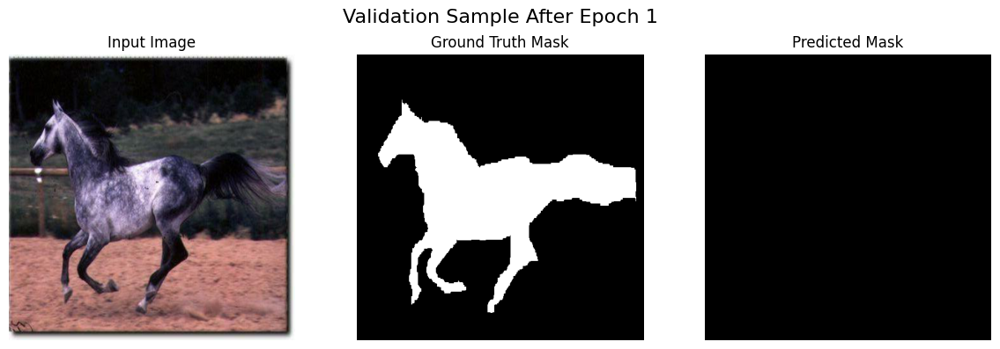


Epoch [2/100]
Train Loss: 0.5117 | IOU: 0.0637 | UOI: 0.9363 | Acc: 0.7541
Precision: 0.4378 | Recall: 0.0689 | F1 Score: 0.1092
Val IOU: 0.2076 | Val UOI: 0.7924 | Val Acc: 0.7975
Val Precision: 0.7188 | Recall: 0.2214 | F1 Score: 0.3325


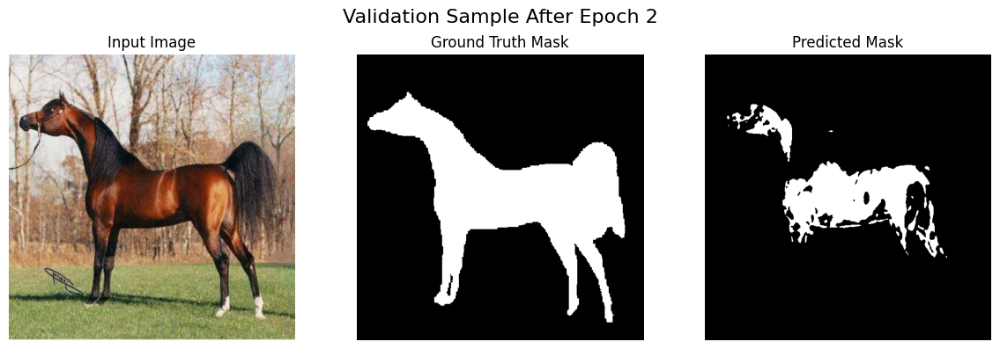

Best model saved.

Epoch [3/100]
Train Loss: 0.4641 | IOU: 0.2900 | UOI: 0.7100 | Acc: 0.7872
Precision: 0.6713 | Recall: 0.3508 | F1 Score: 0.4352
Val IOU: 0.3738 | Val UOI: 0.6262 | Val Acc: 0.7994
Val Precision: 0.5776 | Recall: 0.4937 | F1 Score: 0.5225


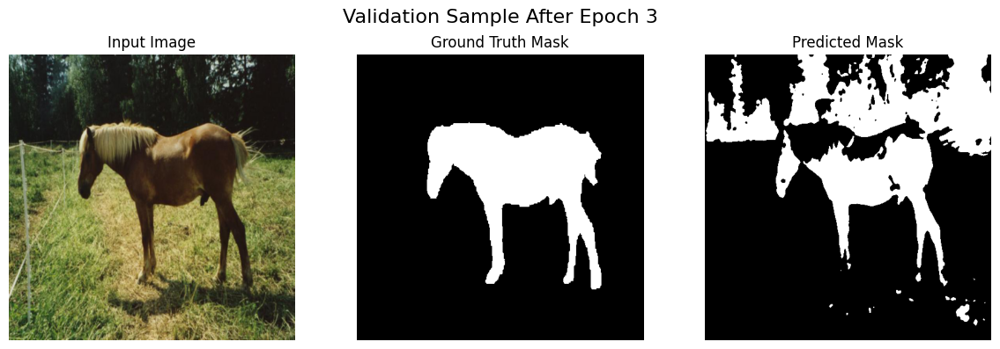

Best model saved.

Epoch [4/100]
Train Loss: 0.4563 | IOU: 0.3200 | UOI: 0.6800 | Acc: 0.7887
Precision: 0.6677 | Recall: 0.3950 | F1 Score: 0.4709
Val IOU: 0.3810 | Val UOI: 0.6190 | Val Acc: 0.8098
Val Precision: 0.6078 | Recall: 0.4852 | F1 Score: 0.5298


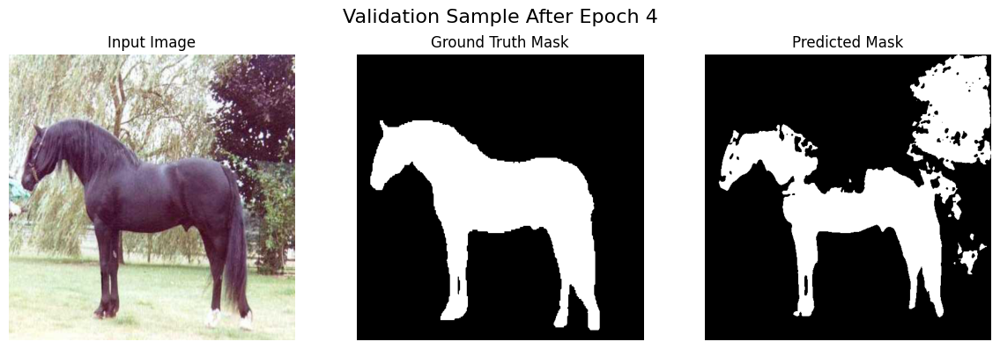

Best model saved.

Epoch [5/100]
Train Loss: 0.4361 | IOU: 0.3699 | UOI: 0.6301 | Acc: 0.7983
Precision: 0.6568 | Recall: 0.4625 | F1 Score: 0.5285
Val IOU: 0.2613 | Val UOI: 0.7387 | Val Acc: 0.8095
Val Precision: 0.6946 | Recall: 0.2890 | F1 Score: 0.4002


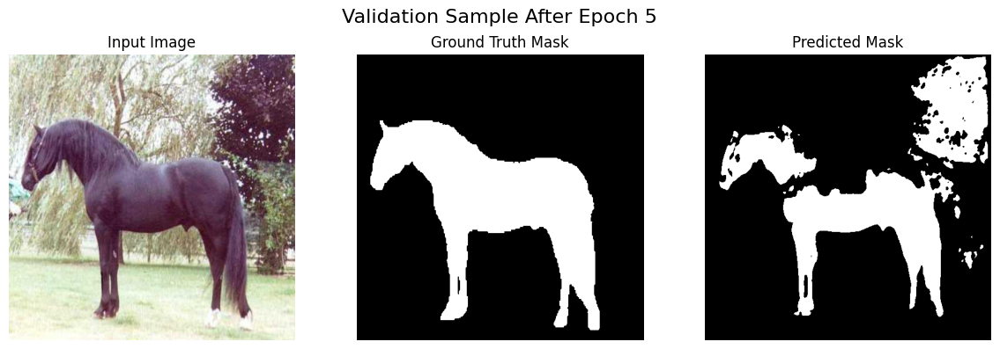


Epoch [6/100]
Train Loss: 0.4263 | IOU: 0.3660 | UOI: 0.6340 | Acc: 0.7971
Precision: 0.6600 | Recall: 0.4641 | F1 Score: 0.5267
Val IOU: 0.3689 | Val UOI: 0.6311 | Val Acc: 0.8205
Val Precision: 0.6560 | Recall: 0.4385 | F1 Score: 0.5174


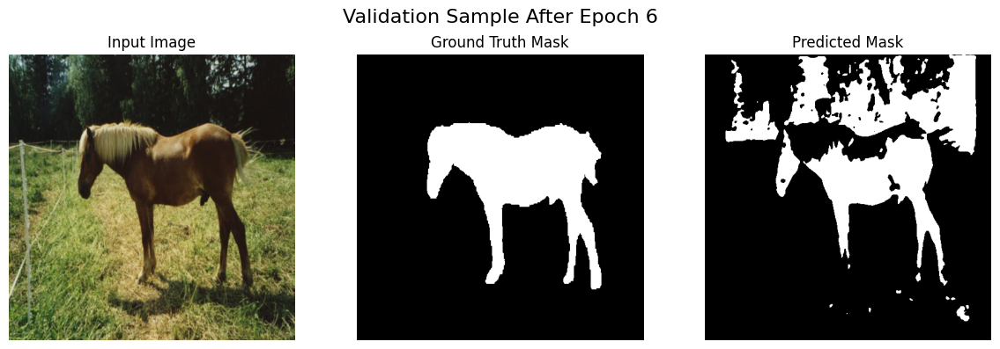


Epoch [7/100]
Train Loss: 0.3949 | IOU: 0.4149 | UOI: 0.5851 | Acc: 0.8148
Precision: 0.6885 | Recall: 0.5188 | F1 Score: 0.5798
Val IOU: 0.4204 | Val UOI: 0.5796 | Val Acc: 0.8345
Val Precision: 0.6696 | Recall: 0.5052 | F1 Score: 0.5676


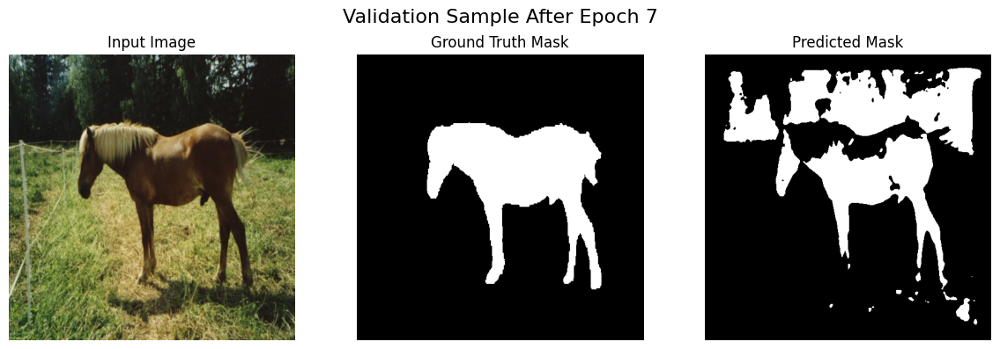

Best model saved.

Epoch [8/100]
Train Loss: 0.3766 | IOU: 0.4438 | UOI: 0.5562 | Acc: 0.8244
Precision: 0.7084 | Recall: 0.5469 | F1 Score: 0.6081
Val IOU: 0.4572 | Val UOI: 0.5428 | Val Acc: 0.8433
Val Precision: 0.6803 | Recall: 0.5539 | F1 Score: 0.6020


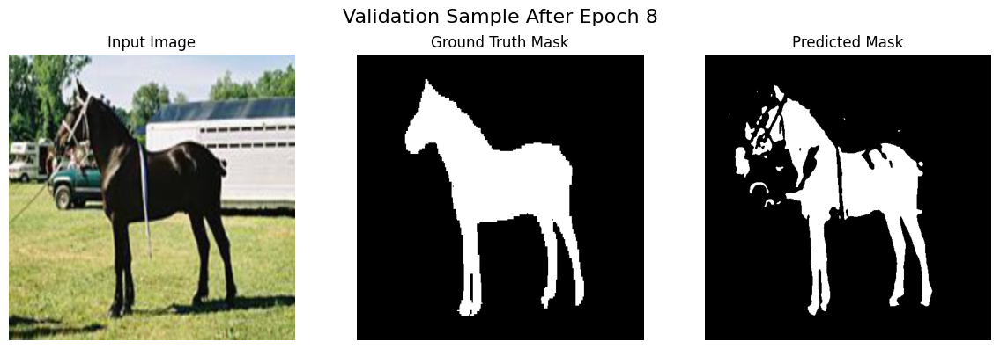

Best model saved.

Epoch [9/100]
Train Loss: 0.3608 | IOU: 0.4632 | UOI: 0.5368 | Acc: 0.8299
Precision: 0.7233 | Recall: 0.5738 | F1 Score: 0.6289
Val IOU: 0.4587 | Val UOI: 0.5413 | Val Acc: 0.8460
Val Precision: 0.6849 | Recall: 0.5543 | F1 Score: 0.6041


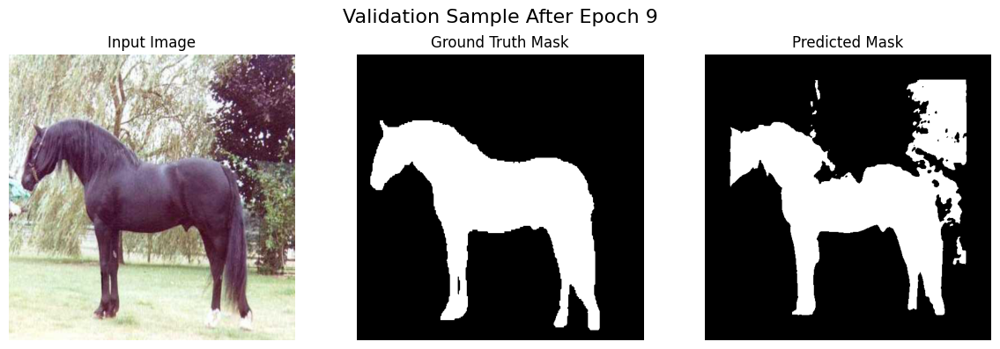

Best model saved.

Epoch [10/100]
Train Loss: 0.3518 | IOU: 0.4949 | UOI: 0.5051 | Acc: 0.8399
Precision: 0.7321 | Recall: 0.6163 | F1 Score: 0.6564
Val IOU: 0.5196 | Val UOI: 0.4804 | Val Acc: 0.8627
Val Precision: 0.7507 | Recall: 0.6226 | F1 Score: 0.6775


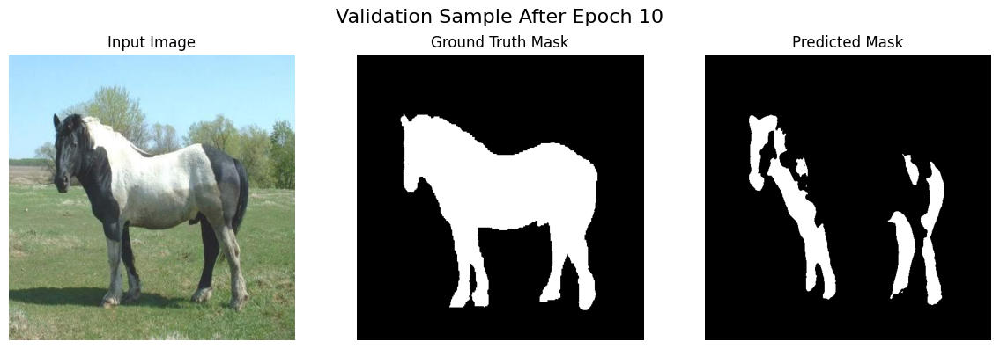

Best model saved.

Epoch [11/100]
Train Loss: 0.3450 | IOU: 0.5132 | UOI: 0.4868 | Acc: 0.8455
Precision: 0.7423 | Recall: 0.6367 | F1 Score: 0.6713
Val IOU: 0.4970 | Val UOI: 0.5030 | Val Acc: 0.8544
Val Precision: 0.7124 | Recall: 0.6143 | F1 Score: 0.6494


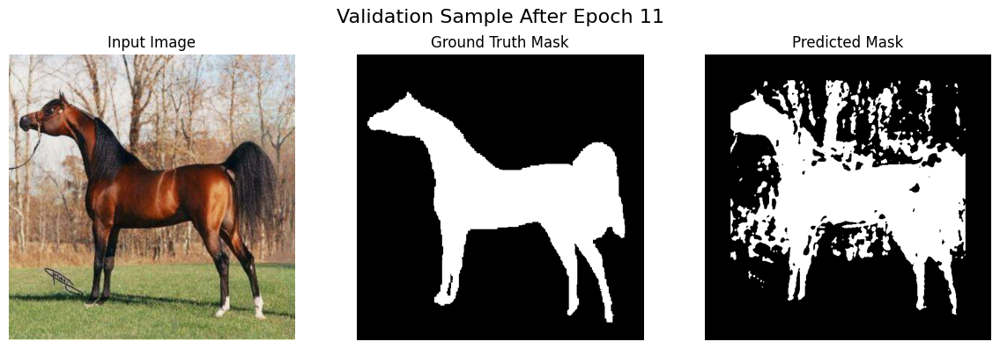


Epoch [12/100]
Train Loss: 0.3487 | IOU: 0.4747 | UOI: 0.5253 | Acc: 0.8338
Precision: 0.7377 | Recall: 0.5996 | F1 Score: 0.6393
Val IOU: 0.4496 | Val UOI: 0.5504 | Val Acc: 0.8521
Val Precision: 0.7344 | Recall: 0.5161 | F1 Score: 0.5966


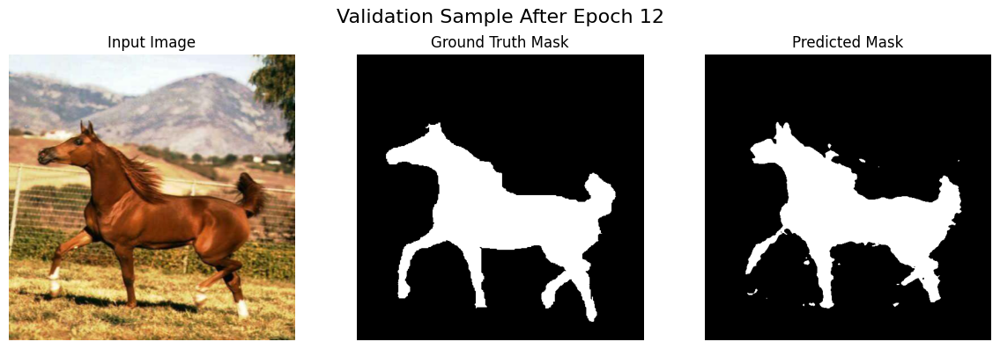


Epoch [13/100]
Train Loss: 0.3274 | IOU: 0.5145 | UOI: 0.4855 | Acc: 0.8502
Precision: 0.7604 | Recall: 0.6282 | F1 Score: 0.6751
Val IOU: 0.5551 | Val UOI: 0.4449 | Val Acc: 0.8787
Val Precision: 0.8099 | Recall: 0.6359 | F1 Score: 0.7086


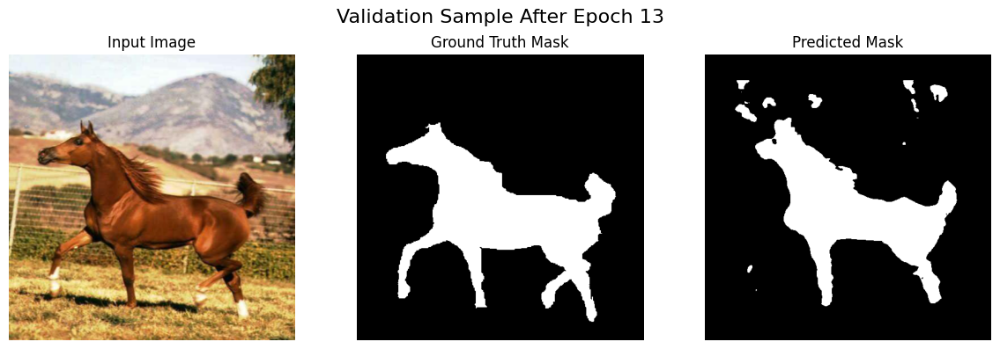

Best model saved.

Epoch [14/100]
Train Loss: 0.3044 | IOU: 0.5601 | UOI: 0.4399 | Acc: 0.8655
Precision: 0.7690 | Recall: 0.6773 | F1 Score: 0.7129
Val IOU: 0.5980 | Val UOI: 0.4020 | Val Acc: 0.8817
Val Precision: 0.7698 | Recall: 0.7384 | F1 Score: 0.7442


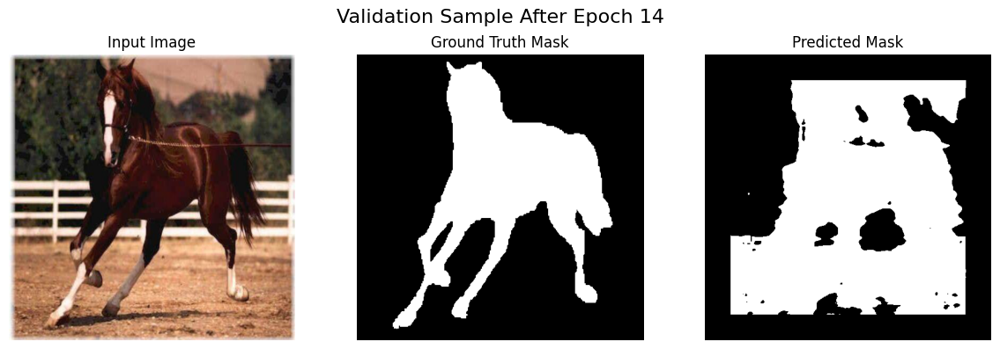

Best model saved.

Epoch [15/100]
Train Loss: 0.3095 | IOU: 0.5426 | UOI: 0.4574 | Acc: 0.8600
Precision: 0.7795 | Recall: 0.6560 | F1 Score: 0.7001
Val IOU: 0.5914 | Val UOI: 0.4086 | Val Acc: 0.8835
Val Precision: 0.7762 | Recall: 0.7109 | F1 Score: 0.7364


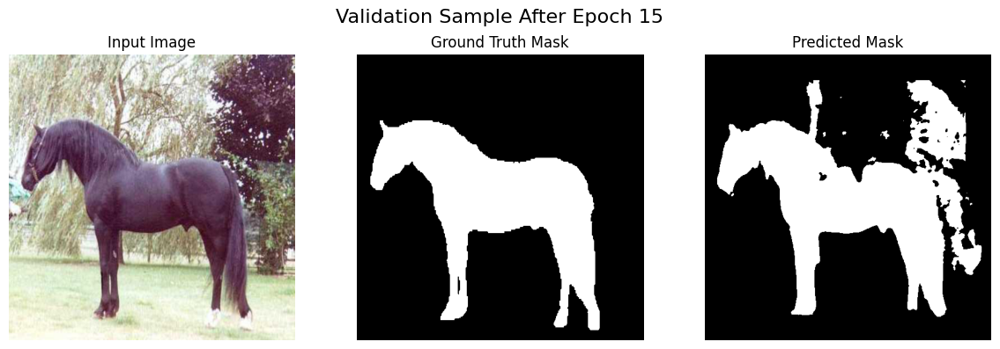


Epoch [16/100]
Train Loss: 0.2981 | IOU: 0.5735 | UOI: 0.4265 | Acc: 0.8653
Precision: 0.7600 | Recall: 0.7104 | F1 Score: 0.7261
Val IOU: 0.5642 | Val UOI: 0.4358 | Val Acc: 0.8827
Val Precision: 0.8092 | Recall: 0.6420 | F1 Score: 0.7110


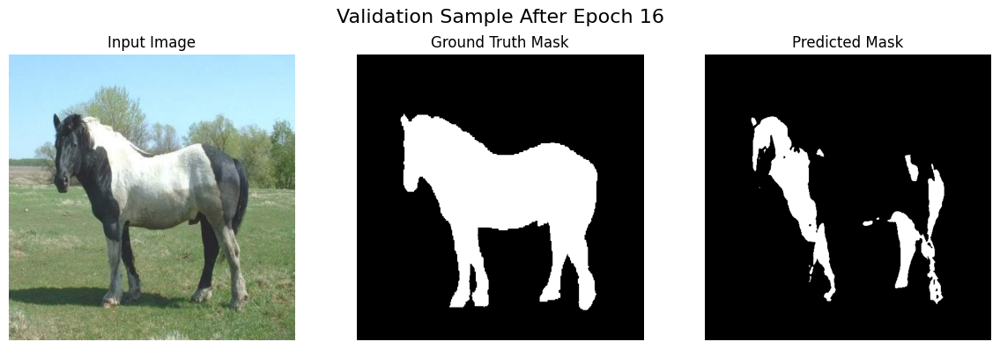


Epoch [17/100]
Train Loss: 0.2814 | IOU: 0.6041 | UOI: 0.3959 | Acc: 0.8761
Precision: 0.7690 | Recall: 0.7468 | F1 Score: 0.7501
Val IOU: 0.6433 | Val UOI: 0.3567 | Val Acc: 0.8900
Val Precision: 0.7438 | Recall: 0.8277 | F1 Score: 0.7803


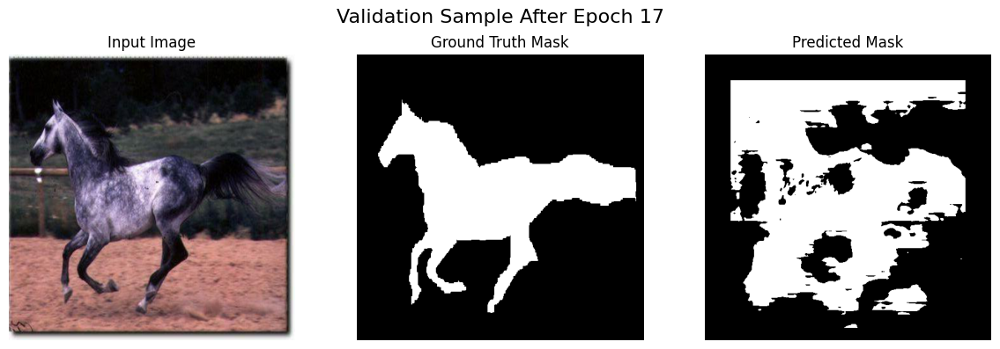

Best model saved.

Epoch [18/100]
Train Loss: 0.2672 | IOU: 0.6224 | UOI: 0.3776 | Acc: 0.8821
Precision: 0.7911 | Recall: 0.7530 | F1 Score: 0.7652
Val IOU: 0.6681 | Val UOI: 0.3319 | Val Acc: 0.9036
Val Precision: 0.7932 | Recall: 0.8084 | F1 Score: 0.7988


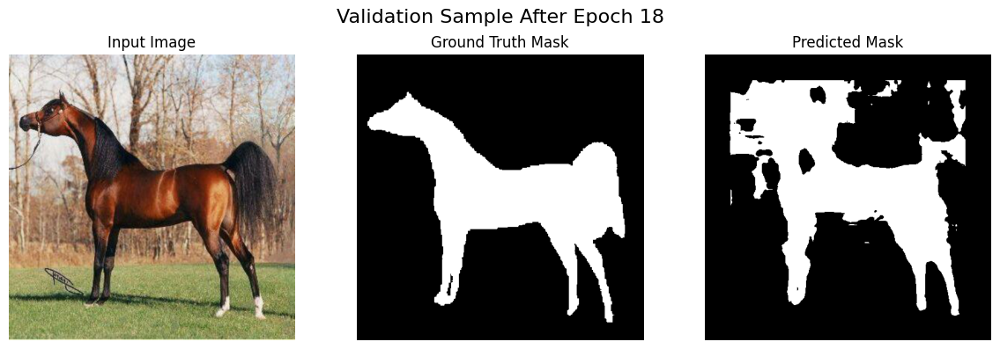

Best model saved.

Epoch [19/100]
Train Loss: 0.2583 | IOU: 0.6368 | UOI: 0.3632 | Acc: 0.8891
Precision: 0.7962 | Recall: 0.7691 | F1 Score: 0.7758
Val IOU: 0.6652 | Val UOI: 0.3348 | Val Acc: 0.9013
Val Precision: 0.7741 | Recall: 0.8233 | F1 Score: 0.7950


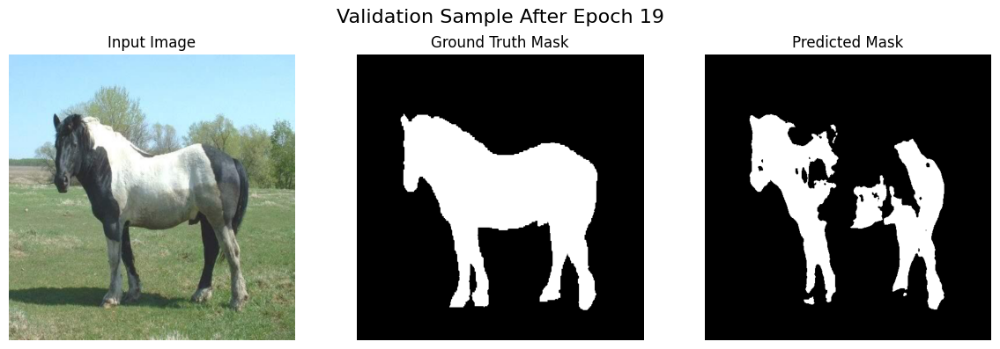


Epoch [20/100]
Train Loss: 0.2620 | IOU: 0.6291 | UOI: 0.3709 | Acc: 0.8883
Precision: 0.8149 | Recall: 0.7492 | F1 Score: 0.7680
Val IOU: 0.6555 | Val UOI: 0.3445 | Val Acc: 0.8986
Val Precision: 0.7784 | Recall: 0.8089 | F1 Score: 0.7880


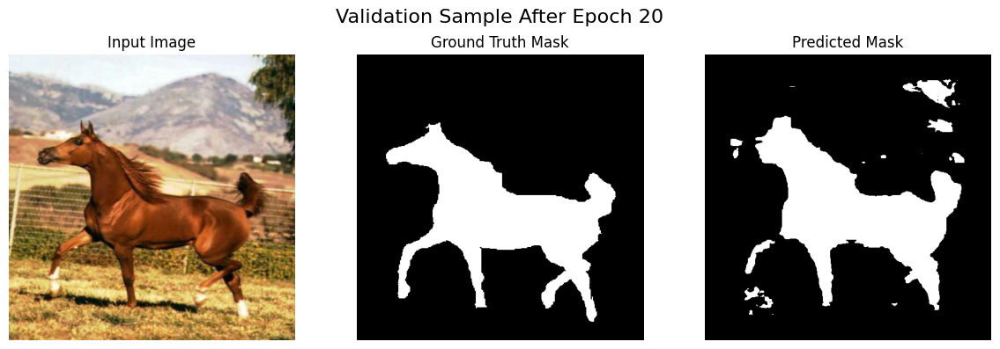


Epoch [21/100]
Train Loss: 0.2561 | IOU: 0.6308 | UOI: 0.3692 | Acc: 0.8879
Precision: 0.7986 | Recall: 0.7578 | F1 Score: 0.7721
Val IOU: 0.6703 | Val UOI: 0.3297 | Val Acc: 0.9105
Val Precision: 0.8422 | Recall: 0.7688 | F1 Score: 0.7994


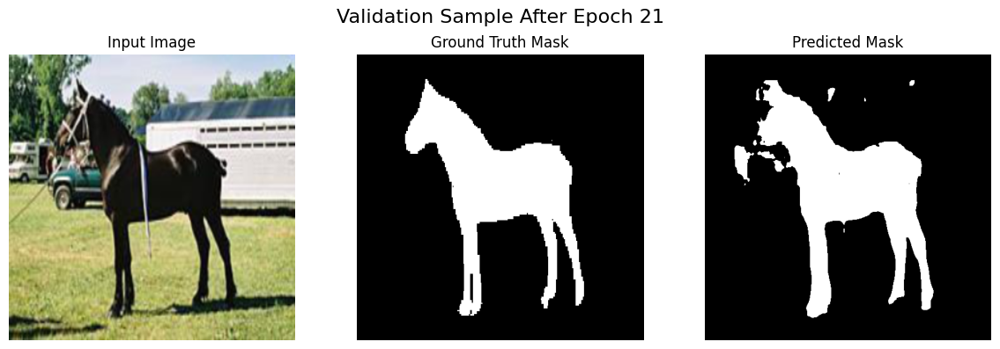

Best model saved.

Epoch [22/100]
Train Loss: 0.2431 | IOU: 0.6503 | UOI: 0.3497 | Acc: 0.8948
Precision: 0.8211 | Recall: 0.7689 | F1 Score: 0.7864
Val IOU: 0.6932 | Val UOI: 0.3068 | Val Acc: 0.9119
Val Precision: 0.8099 | Recall: 0.8310 | F1 Score: 0.8166


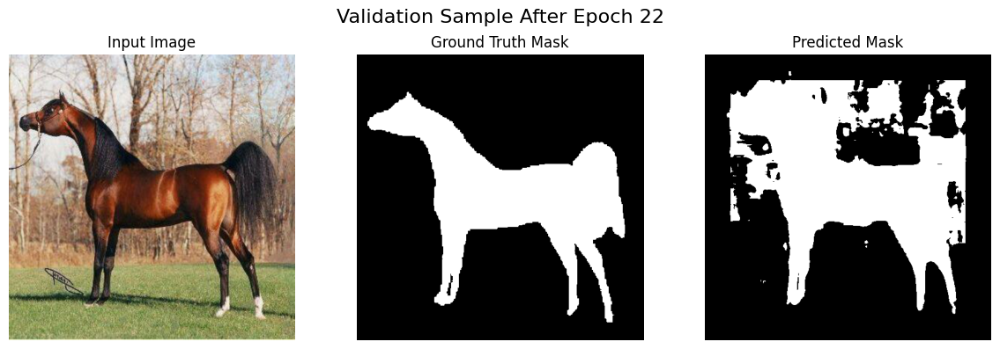

Best model saved.

Epoch [23/100]
Train Loss: 0.2300 | IOU: 0.6754 | UOI: 0.3246 | Acc: 0.9021
Precision: 0.8176 | Recall: 0.8040 | F1 Score: 0.8045
Val IOU: 0.6335 | Val UOI: 0.3665 | Val Acc: 0.9027
Val Precision: 0.8541 | Recall: 0.7161 | F1 Score: 0.7709


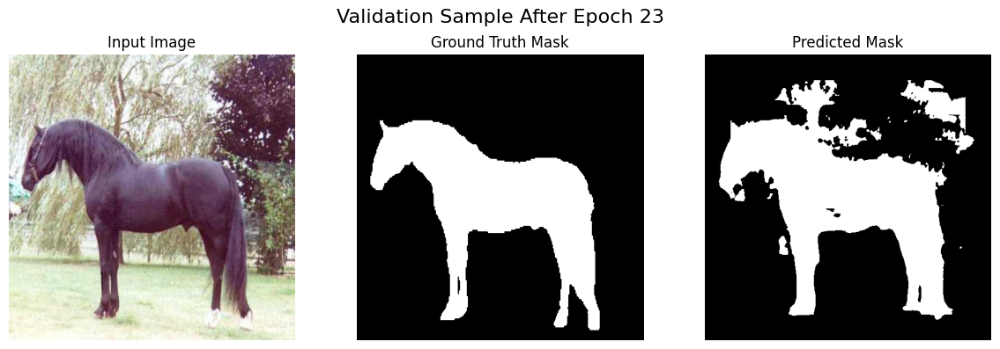


Epoch [24/100]
Train Loss: 0.2202 | IOU: 0.6855 | UOI: 0.3145 | Acc: 0.9060
Precision: 0.8246 | Recall: 0.8114 | F1 Score: 0.8125
Val IOU: 0.7131 | Val UOI: 0.2869 | Val Acc: 0.9164
Val Precision: 0.8123 | Recall: 0.8593 | F1 Score: 0.8311


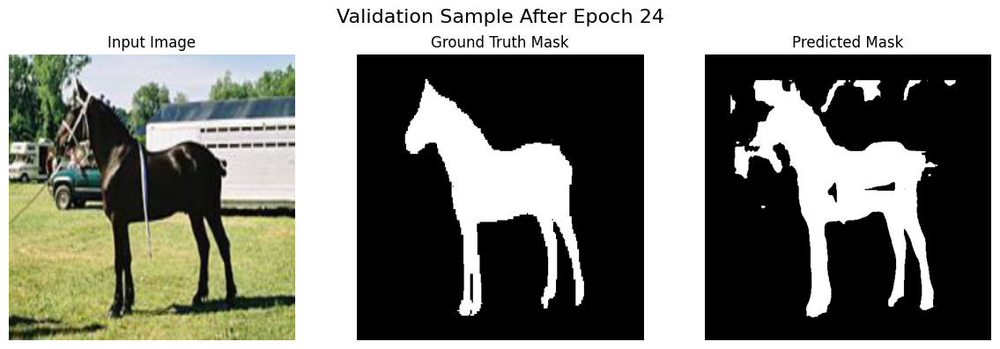

Best model saved.

Epoch [25/100]
Train Loss: 0.2182 | IOU: 0.6986 | UOI: 0.3014 | Acc: 0.9107
Precision: 0.8444 | Recall: 0.8096 | F1 Score: 0.8204
Val IOU: 0.7013 | Val UOI: 0.2987 | Val Acc: 0.9184
Val Precision: 0.8510 | Recall: 0.8038 | F1 Score: 0.8226


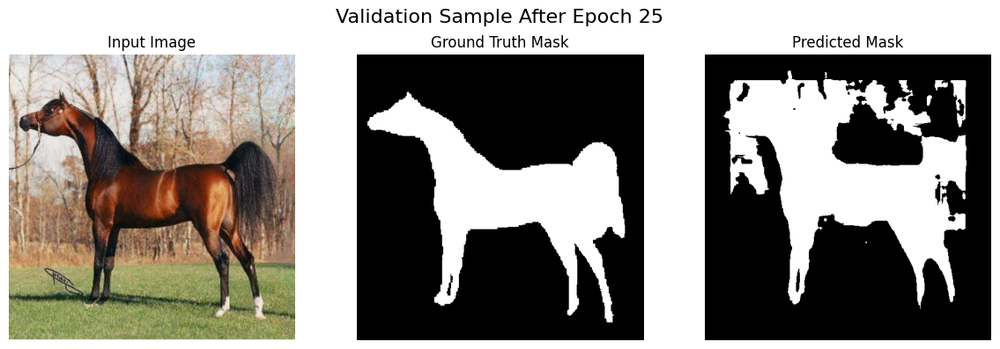


Epoch [26/100]
Train Loss: 0.2030 | IOU: 0.7139 | UOI: 0.2861 | Acc: 0.9157
Precision: 0.8502 | Recall: 0.8205 | F1 Score: 0.8321
Val IOU: 0.7237 | Val UOI: 0.2763 | Val Acc: 0.9210
Val Precision: 0.8212 | Recall: 0.8616 | F1 Score: 0.8379


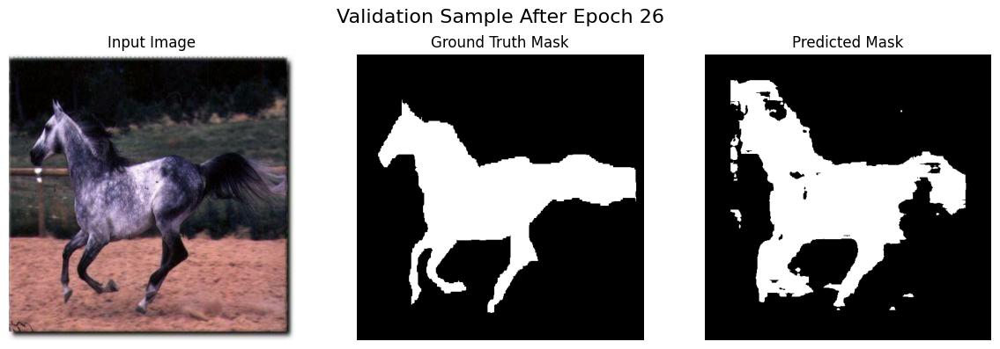

Best model saved.

Epoch [27/100]
Train Loss: 0.1993 | IOU: 0.7158 | UOI: 0.2842 | Acc: 0.9160
Precision: 0.8496 | Recall: 0.8250 | F1 Score: 0.8331
Val IOU: 0.7232 | Val UOI: 0.2768 | Val Acc: 0.9198
Val Precision: 0.8092 | Recall: 0.8745 | F1 Score: 0.8380


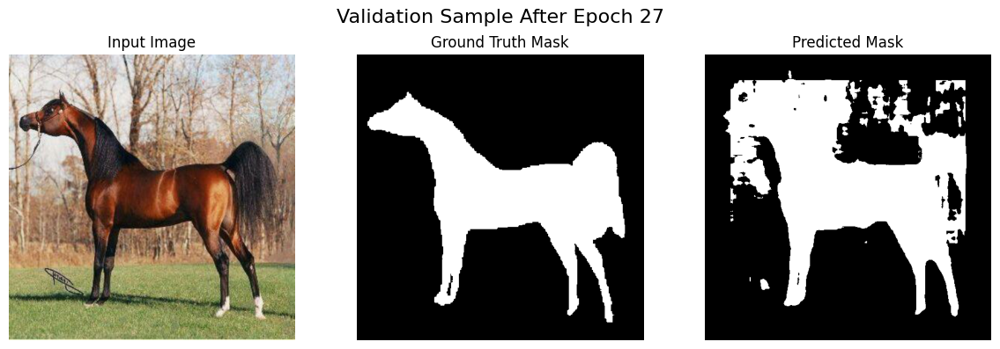


Epoch [28/100]
Train Loss: 0.2023 | IOU: 0.7149 | UOI: 0.2851 | Acc: 0.9159
Precision: 0.8429 | Recall: 0.8326 | F1 Score: 0.8326
Val IOU: 0.7149 | Val UOI: 0.2851 | Val Acc: 0.9242
Val Precision: 0.8694 | Recall: 0.8033 | F1 Score: 0.8319


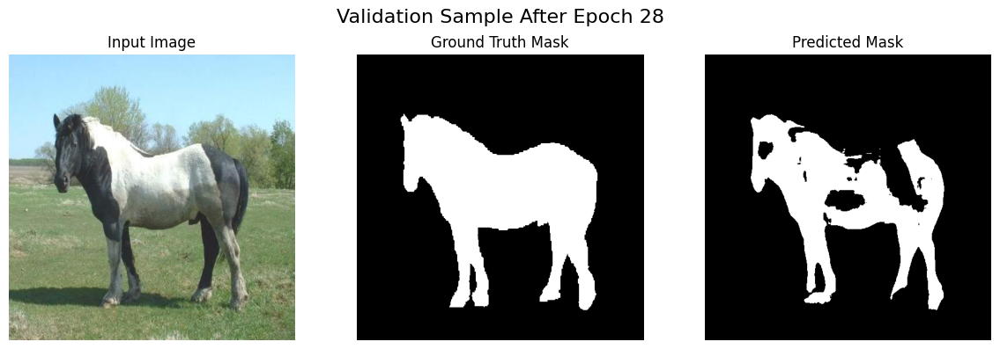


Epoch [29/100]
Train Loss: 0.1894 | IOU: 0.7305 | UOI: 0.2695 | Acc: 0.9216
Precision: 0.8601 | Recall: 0.8352 | F1 Score: 0.8431
Val IOU: 0.7224 | Val UOI: 0.2776 | Val Acc: 0.9258
Val Precision: 0.8669 | Recall: 0.8175 | F1 Score: 0.8361


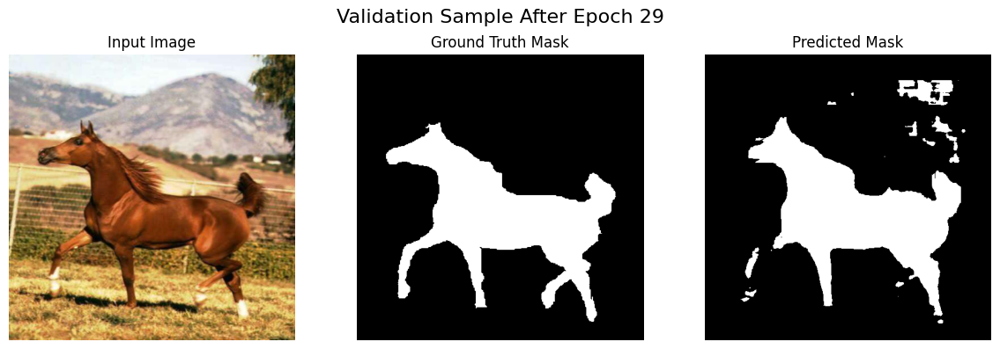


Epoch [30/100]
Train Loss: 0.1759 | IOU: 0.7503 | UOI: 0.2497 | Acc: 0.9278
Precision: 0.8665 | Recall: 0.8495 | F1 Score: 0.8566
Val IOU: 0.7332 | Val UOI: 0.2668 | Val Acc: 0.9307
Val Precision: 0.8964 | Recall: 0.8041 | F1 Score: 0.8441


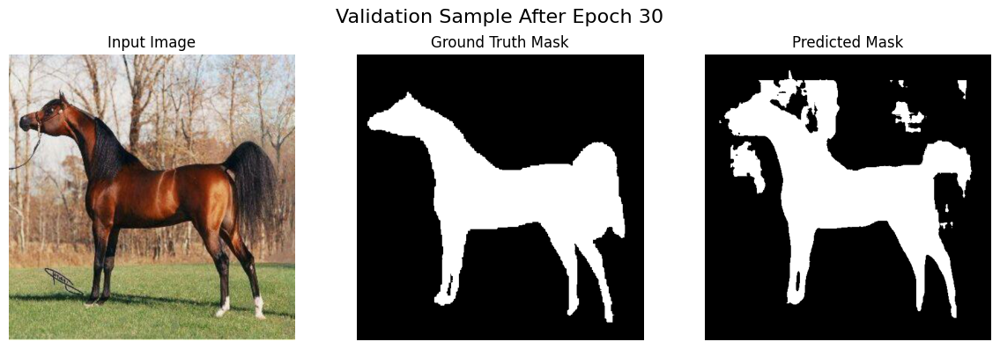

Best model saved.

Epoch [31/100]
Train Loss: 0.1745 | IOU: 0.7501 | UOI: 0.2499 | Acc: 0.9278
Precision: 0.8611 | Recall: 0.8558 | F1 Score: 0.8564
Val IOU: 0.7093 | Val UOI: 0.2907 | Val Acc: 0.9259
Val Precision: 0.9020 | Recall: 0.7718 | F1 Score: 0.8256


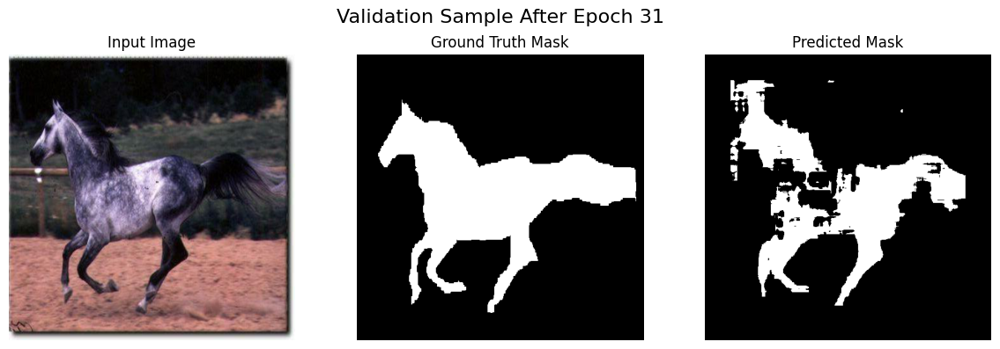


Epoch [32/100]
Train Loss: 0.1699 | IOU: 0.7540 | UOI: 0.2460 | Acc: 0.9301
Precision: 0.8712 | Recall: 0.8505 | F1 Score: 0.8586
Val IOU: 0.7081 | Val UOI: 0.2919 | Val Acc: 0.9255
Val Precision: 0.8998 | Recall: 0.7722 | F1 Score: 0.8252


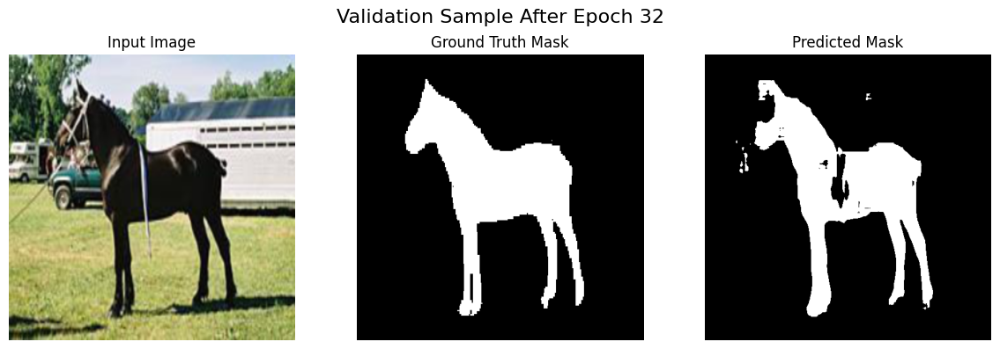


Epoch [33/100]
Train Loss: 0.1768 | IOU: 0.7487 | UOI: 0.2513 | Acc: 0.9270
Precision: 0.8706 | Recall: 0.8490 | F1 Score: 0.8551
Val IOU: 0.6567 | Val UOI: 0.3433 | Val Acc: 0.9154
Val Precision: 0.9290 | Recall: 0.6951 | F1 Score: 0.7867


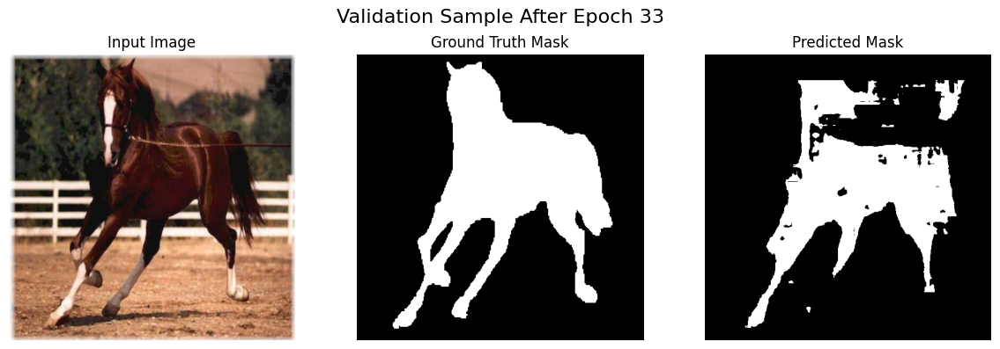


Epoch [34/100]
Train Loss: 0.1764 | IOU: 0.7522 | UOI: 0.2478 | Acc: 0.9290
Precision: 0.8698 | Recall: 0.8511 | F1 Score: 0.8576
Val IOU: 0.7134 | Val UOI: 0.2866 | Val Acc: 0.9149
Val Precision: 0.7856 | Recall: 0.8905 | F1 Score: 0.8299


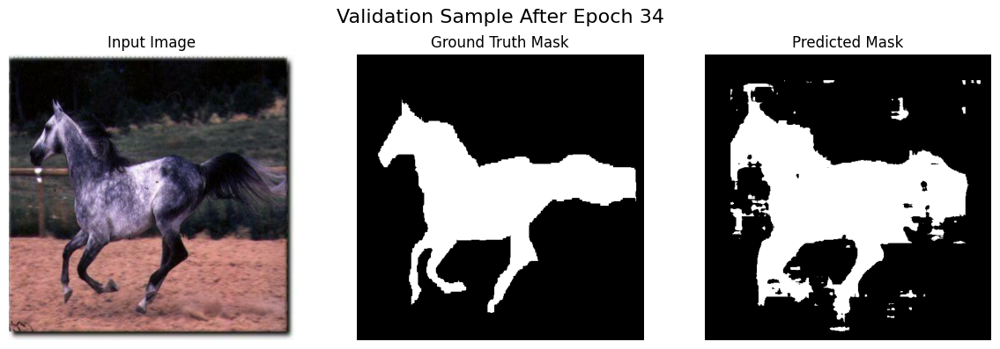


Epoch [35/100]
Train Loss: 0.1723 | IOU: 0.7573 | UOI: 0.2427 | Acc: 0.9299
Precision: 0.8740 | Recall: 0.8545 | F1 Score: 0.8609
Val IOU: 0.7353 | Val UOI: 0.2647 | Val Acc: 0.9281
Val Precision: 0.8480 | Recall: 0.8484 | F1 Score: 0.8448


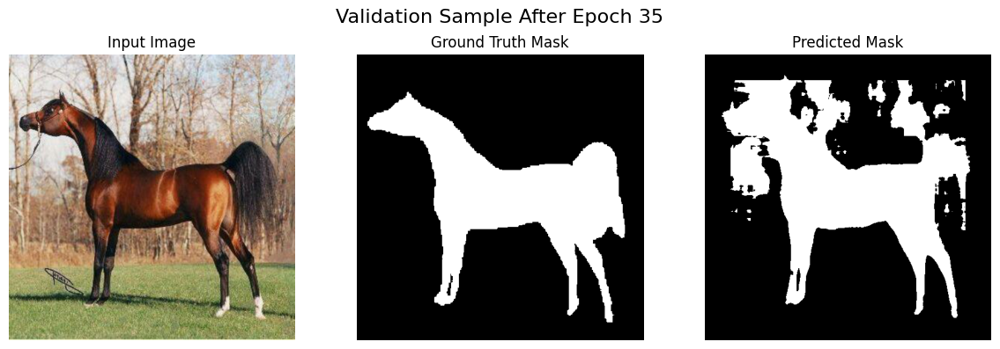

Best model saved.

Epoch [36/100]
Train Loss: 0.1576 | IOU: 0.7745 | UOI: 0.2255 | Acc: 0.9357
Precision: 0.8783 | Recall: 0.8724 | F1 Score: 0.8724
Val IOU: 0.7482 | Val UOI: 0.2518 | Val Acc: 0.9335
Val Precision: 0.8743 | Recall: 0.8394 | F1 Score: 0.8531


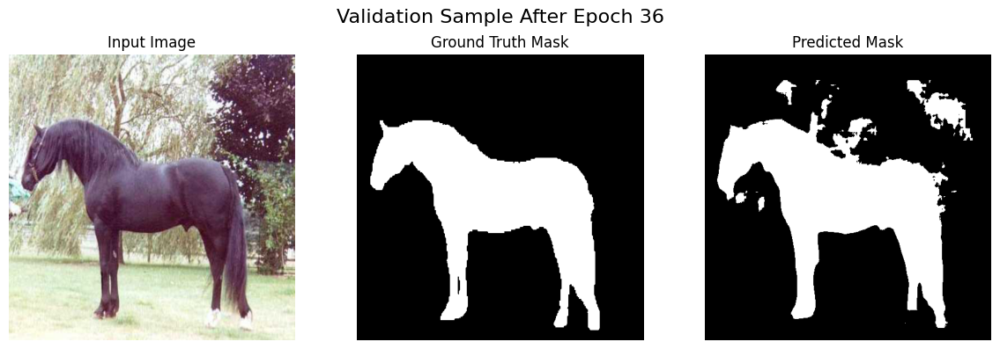

Best model saved.

Epoch [37/100]
Train Loss: 0.1495 | IOU: 0.7823 | UOI: 0.2177 | Acc: 0.9387
Precision: 0.8882 | Recall: 0.8696 | F1 Score: 0.8771
Val IOU: 0.7246 | Val UOI: 0.2754 | Val Acc: 0.9291
Val Precision: 0.9043 | Recall: 0.7854 | F1 Score: 0.8390


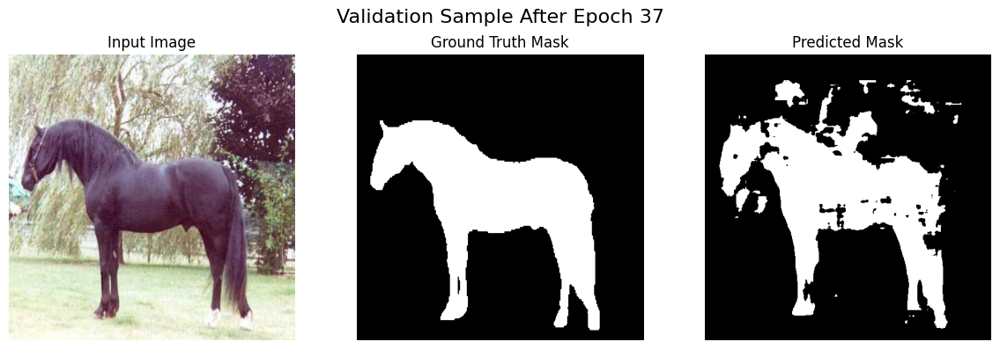


Epoch [38/100]
Train Loss: 0.1449 | IOU: 0.7918 | UOI: 0.2082 | Acc: 0.9408
Precision: 0.8902 | Recall: 0.8795 | F1 Score: 0.8832
Val IOU: 0.7543 | Val UOI: 0.2457 | Val Acc: 0.9341
Val Precision: 0.8600 | Recall: 0.8603 | F1 Score: 0.8580


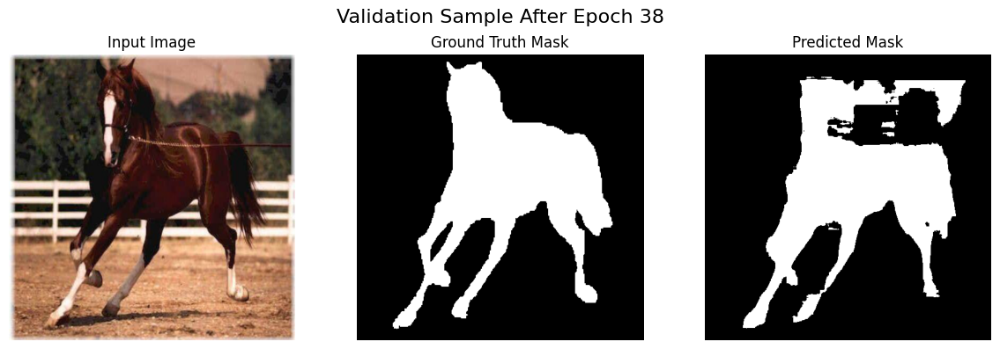

Best model saved.

Epoch [39/100]
Train Loss: 0.1383 | IOU: 0.7969 | UOI: 0.2031 | Acc: 0.9434
Precision: 0.8978 | Recall: 0.8787 | F1 Score: 0.8866
Val IOU: 0.7314 | Val UOI: 0.2686 | Val Acc: 0.9186
Val Precision: 0.7768 | Recall: 0.9259 | F1 Score: 0.8431


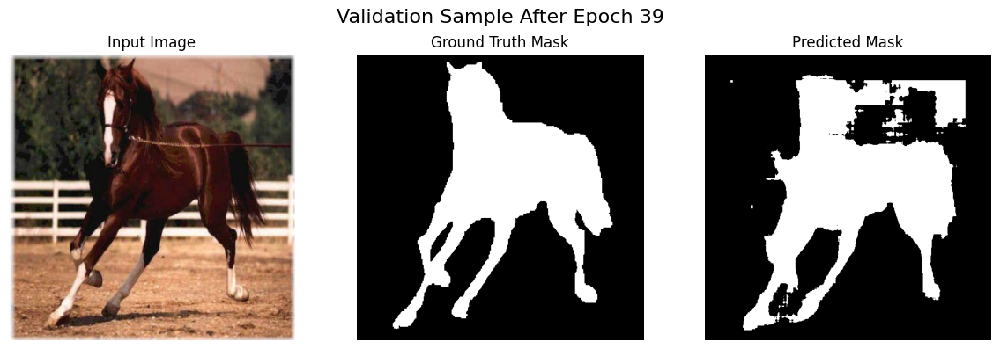


Epoch [40/100]
Train Loss: 0.1447 | IOU: 0.7927 | UOI: 0.2073 | Acc: 0.9420
Precision: 0.8931 | Recall: 0.8787 | F1 Score: 0.8834
Val IOU: 0.7569 | Val UOI: 0.2431 | Val Acc: 0.9366
Val Precision: 0.8856 | Recall: 0.8424 | F1 Score: 0.8592


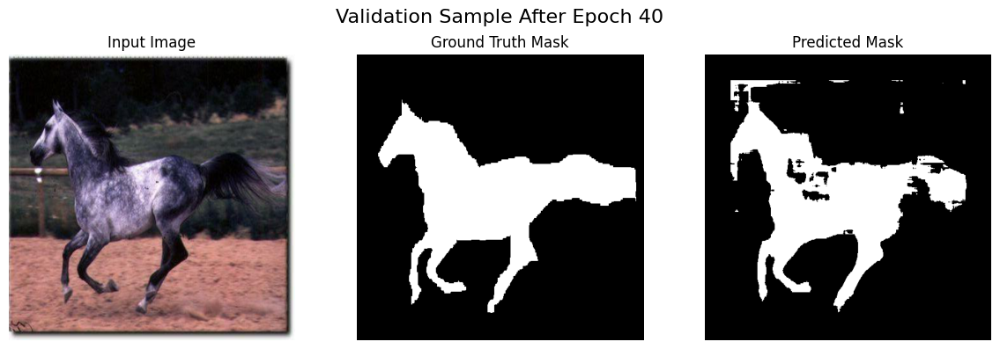

Best model saved.

Epoch [41/100]
Train Loss: 0.1356 | IOU: 0.8048 | UOI: 0.1952 | Acc: 0.9455
Precision: 0.9012 | Recall: 0.8849 | F1 Score: 0.8914
Val IOU: 0.7602 | Val UOI: 0.2398 | Val Acc: 0.9385
Val Precision: 0.9112 | Recall: 0.8237 | F1 Score: 0.8615


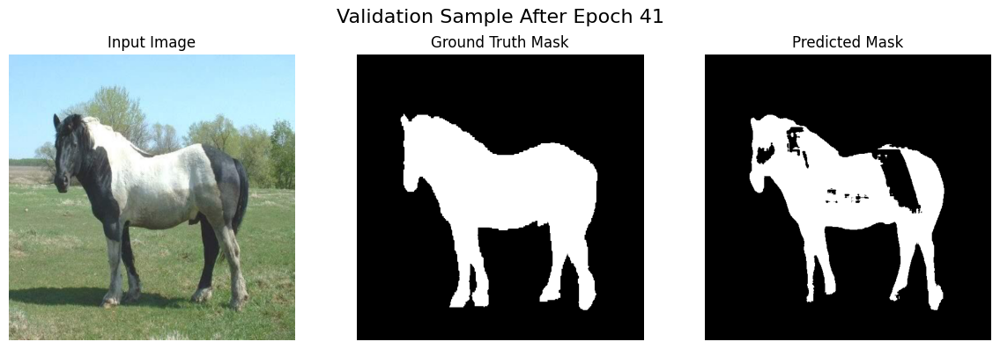

Best model saved.

Epoch [42/100]
Train Loss: 0.1395 | IOU: 0.7966 | UOI: 0.2034 | Acc: 0.9430
Precision: 0.8915 | Recall: 0.8852 | F1 Score: 0.8861
Val IOU: 0.7599 | Val UOI: 0.2401 | Val Acc: 0.9359
Val Precision: 0.8727 | Recall: 0.8558 | F1 Score: 0.8623


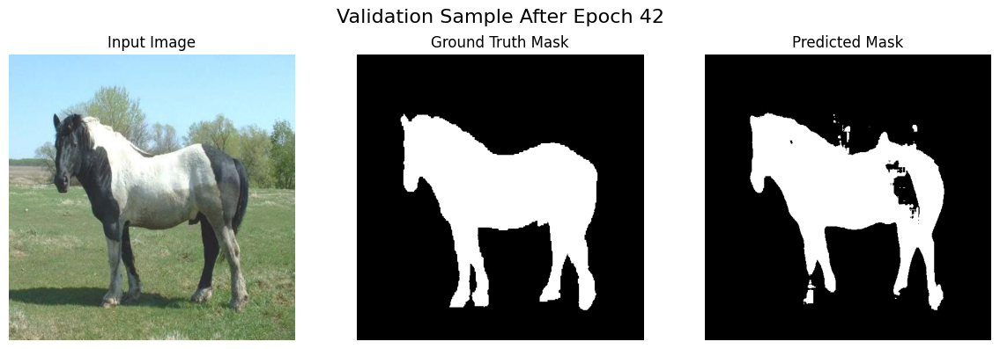


Epoch [43/100]
Train Loss: 0.1326 | IOU: 0.8082 | UOI: 0.1918 | Acc: 0.9468
Precision: 0.9062 | Recall: 0.8840 | F1 Score: 0.8935
Val IOU: 0.7543 | Val UOI: 0.2457 | Val Acc: 0.9368
Val Precision: 0.8945 | Recall: 0.8317 | F1 Score: 0.8571


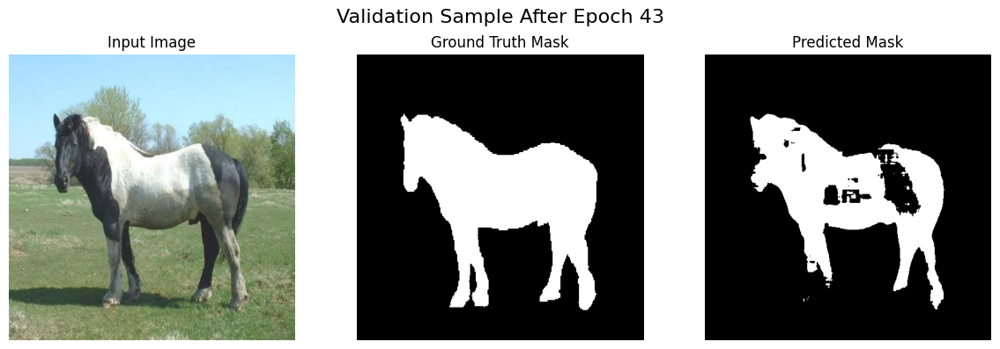


Epoch [44/100]
Train Loss: 0.1251 | IOU: 0.8159 | UOI: 0.1841 | Acc: 0.9491
Precision: 0.9055 | Recall: 0.8942 | F1 Score: 0.8982
Val IOU: 0.7611 | Val UOI: 0.2389 | Val Acc: 0.9340
Val Precision: 0.8413 | Recall: 0.8873 | F1 Score: 0.8624


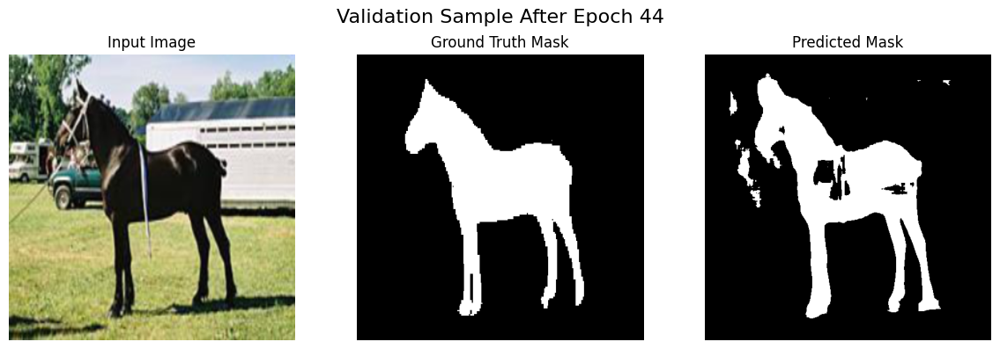

Best model saved.

Epoch [45/100]
Train Loss: 0.1208 | IOU: 0.8258 | UOI: 0.1742 | Acc: 0.9519
Precision: 0.9087 | Recall: 0.9009 | F1 Score: 0.9042
Val IOU: 0.7675 | Val UOI: 0.2325 | Val Acc: 0.9398
Val Precision: 0.8910 | Recall: 0.8480 | F1 Score: 0.8663


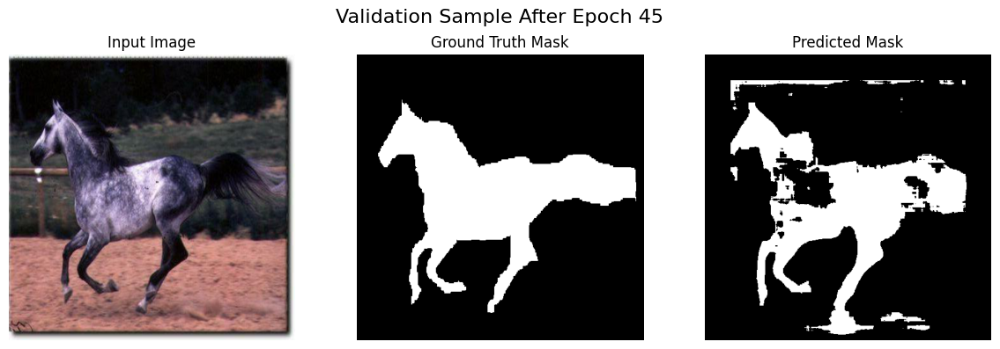

Best model saved.

Epoch [46/100]
Train Loss: 0.1189 | IOU: 0.8272 | UOI: 0.1728 | Acc: 0.9522
Precision: 0.9134 | Recall: 0.8993 | F1 Score: 0.9051
Val IOU: 0.7788 | Val UOI: 0.2212 | Val Acc: 0.9412
Val Precision: 0.8750 | Recall: 0.8790 | F1 Score: 0.8735


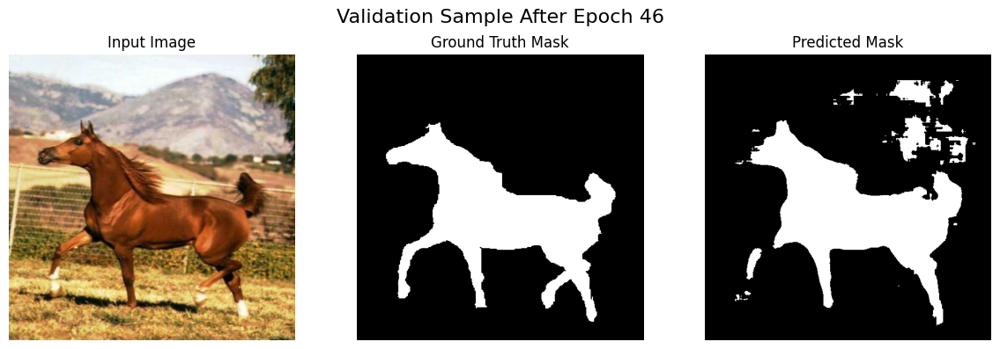

Best model saved.

Epoch [47/100]
Train Loss: 0.1097 | IOU: 0.8405 | UOI: 0.1595 | Acc: 0.9561
Precision: 0.9183 | Recall: 0.9094 | F1 Score: 0.9131
Val IOU: 0.7632 | Val UOI: 0.2368 | Val Acc: 0.9400
Val Precision: 0.9198 | Recall: 0.8199 | F1 Score: 0.8634


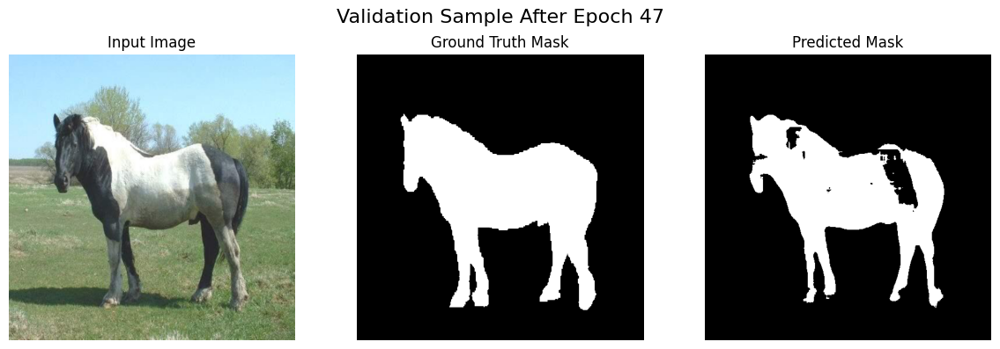


Epoch [48/100]
Train Loss: 0.1074 | IOU: 0.8416 | UOI: 0.1584 | Acc: 0.9565
Precision: 0.9189 | Recall: 0.9106 | F1 Score: 0.9137
Val IOU: 0.7754 | Val UOI: 0.2246 | Val Acc: 0.9417
Val Precision: 0.8930 | Recall: 0.8557 | F1 Score: 0.8716


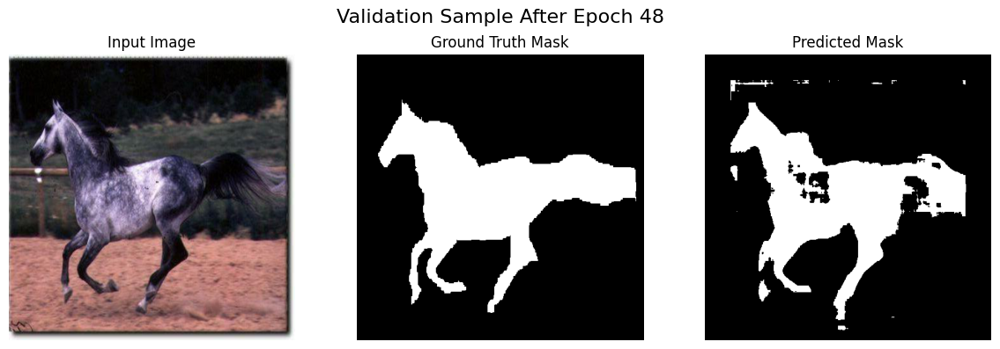


Epoch [49/100]
Train Loss: 0.0968 | IOU: 0.8566 | UOI: 0.1434 | Acc: 0.9612
Precision: 0.9272 | Recall: 0.9194 | F1 Score: 0.9225
Val IOU: 0.7757 | Val UOI: 0.2243 | Val Acc: 0.9370
Val Precision: 0.8366 | Recall: 0.9151 | F1 Score: 0.8718


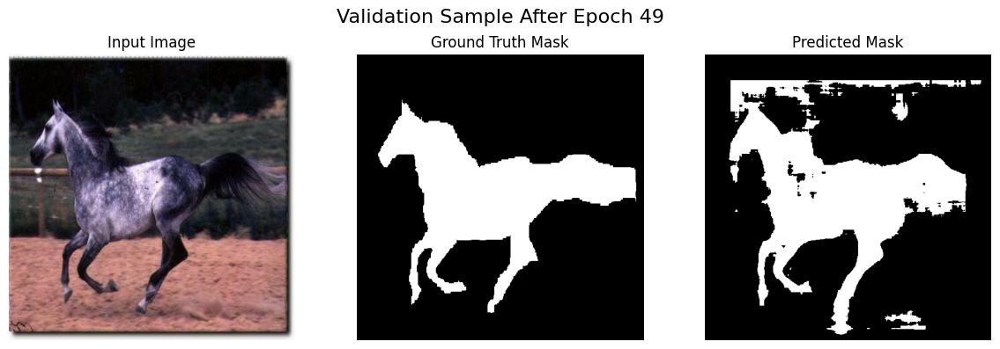


Epoch [50/100]
Train Loss: 0.0927 | IOU: 0.8624 | UOI: 0.1376 | Acc: 0.9630
Precision: 0.9328 | Recall: 0.9206 | F1 Score: 0.9259
Val IOU: 0.7814 | Val UOI: 0.2186 | Val Acc: 0.9418
Val Precision: 0.8699 | Recall: 0.8864 | F1 Score: 0.8750


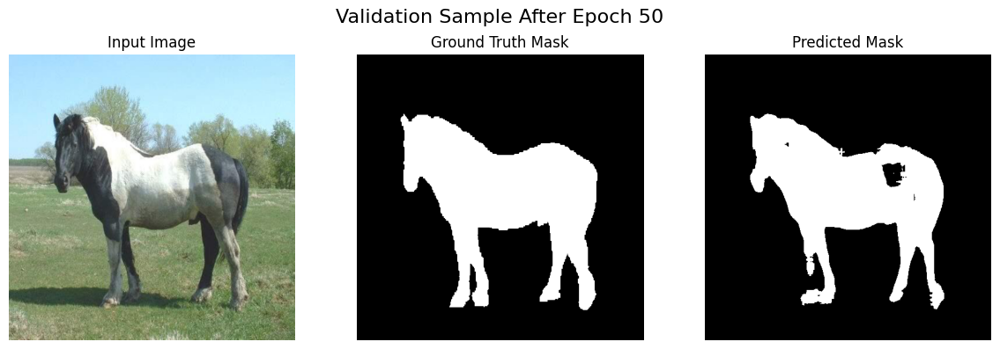

Best model saved.

Epoch [51/100]
Train Loss: 0.0903 | IOU: 0.8672 | UOI: 0.1328 | Acc: 0.9640
Precision: 0.9316 | Recall: 0.9269 | F1 Score: 0.9287
Val IOU: 0.7600 | Val UOI: 0.2400 | Val Acc: 0.9392
Val Precision: 0.9067 | Recall: 0.8223 | F1 Score: 0.8605


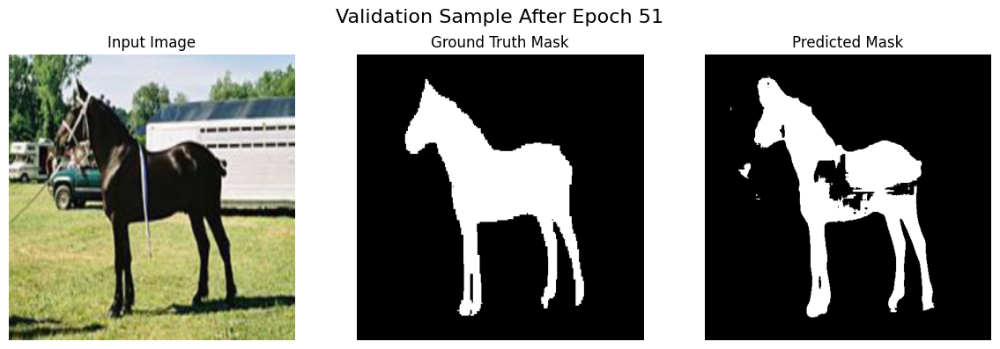


Epoch [52/100]
Train Loss: 0.0839 | IOU: 0.8767 | UOI: 0.1233 | Acc: 0.9668
Precision: 0.9386 | Recall: 0.9310 | F1 Score: 0.9341
Val IOU: 0.7969 | Val UOI: 0.2031 | Val Acc: 0.9450
Val Precision: 0.8719 | Recall: 0.9044 | F1 Score: 0.8854


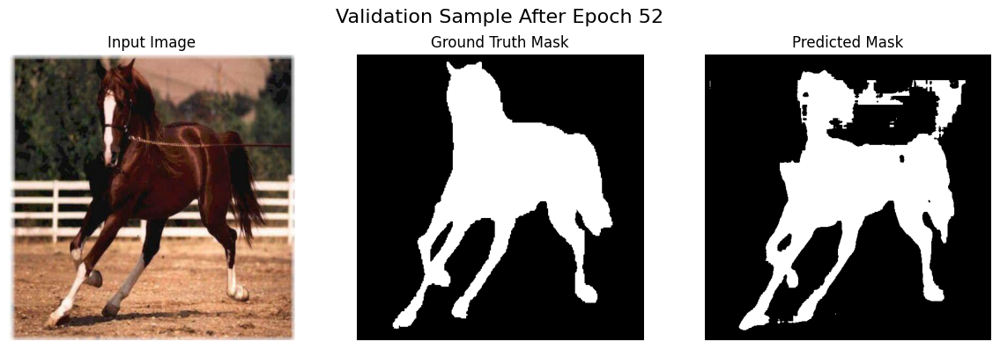

Best model saved.

Epoch [53/100]
Train Loss: 0.0756 | IOU: 0.8883 | UOI: 0.1117 | Acc: 0.9701
Precision: 0.9418 | Recall: 0.9404 | F1 Score: 0.9407
Val IOU: 0.7923 | Val UOI: 0.2077 | Val Acc: 0.9464
Val Precision: 0.9050 | Recall: 0.8661 | F1 Score: 0.8824


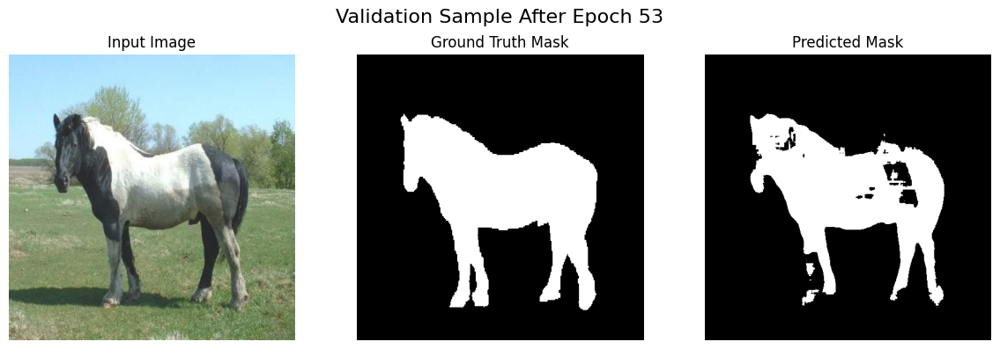


Epoch [54/100]
Train Loss: 0.0816 | IOU: 0.8822 | UOI: 0.1178 | Acc: 0.9684
Precision: 0.9404 | Recall: 0.9353 | F1 Score: 0.9371
Val IOU: 0.7763 | Val UOI: 0.2237 | Val Acc: 0.9396
Val Precision: 0.8655 | Recall: 0.8828 | F1 Score: 0.8719


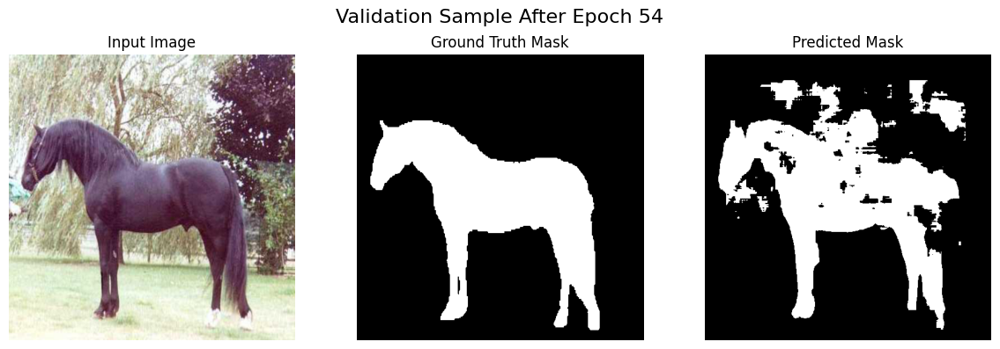


Epoch [55/100]
Train Loss: 0.0975 | IOU: 0.8586 | UOI: 0.1414 | Acc: 0.9616
Precision: 0.9291 | Recall: 0.9201 | F1 Score: 0.9235
Val IOU: 0.7701 | Val UOI: 0.2299 | Val Acc: 0.9389
Val Precision: 0.8730 | Recall: 0.8664 | F1 Score: 0.8680


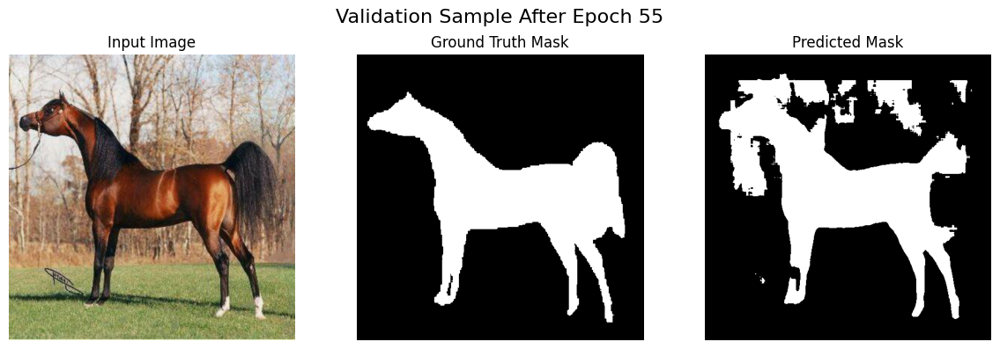


Epoch [56/100]
Train Loss: 0.0777 | IOU: 0.8849 | UOI: 0.1151 | Acc: 0.9692
Precision: 0.9431 | Recall: 0.9355 | F1 Score: 0.9389
Val IOU: 0.7909 | Val UOI: 0.2091 | Val Acc: 0.9462
Val Precision: 0.9033 | Recall: 0.8669 | F1 Score: 0.8814


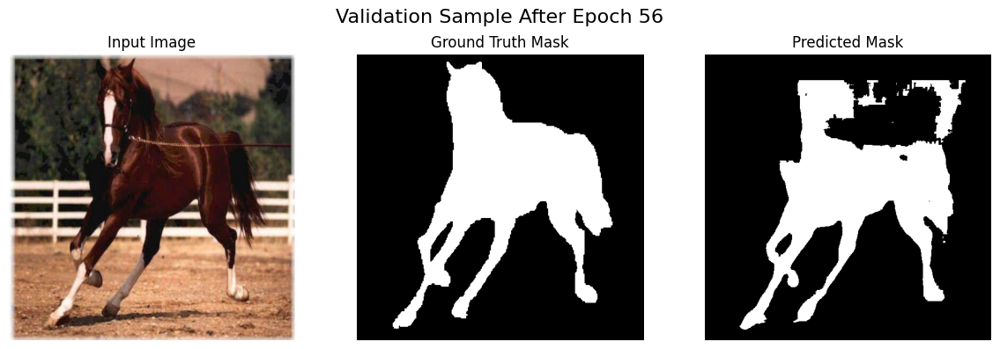


Epoch [57/100]
Train Loss: 0.0641 | IOU: 0.9044 | UOI: 0.0956 | Acc: 0.9747
Precision: 0.9508 | Recall: 0.9491 | F1 Score: 0.9498
Val IOU: 0.7822 | Val UOI: 0.2178 | Val Acc: 0.9448
Val Precision: 0.9183 | Recall: 0.8423 | F1 Score: 0.8760


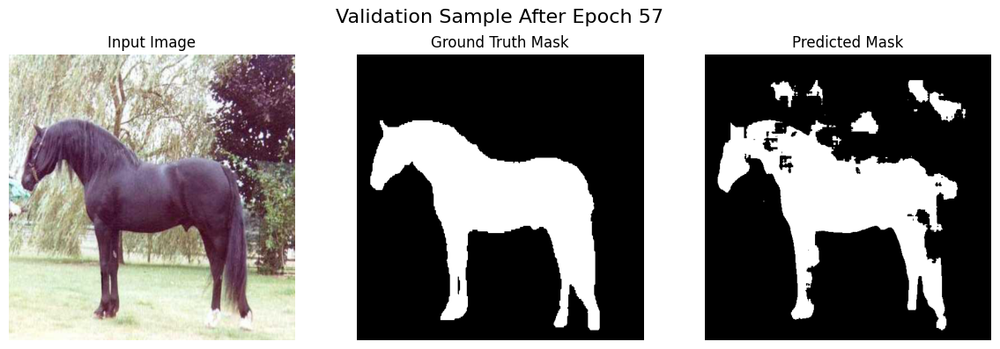


Epoch [58/100]
Train Loss: 0.0683 | IOU: 0.8993 | UOI: 0.1007 | Acc: 0.9732
Precision: 0.9513 | Recall: 0.9435 | F1 Score: 0.9469
Val IOU: 0.7840 | Val UOI: 0.2160 | Val Acc: 0.9385
Val Precision: 0.8362 | Recall: 0.9276 | F1 Score: 0.8775


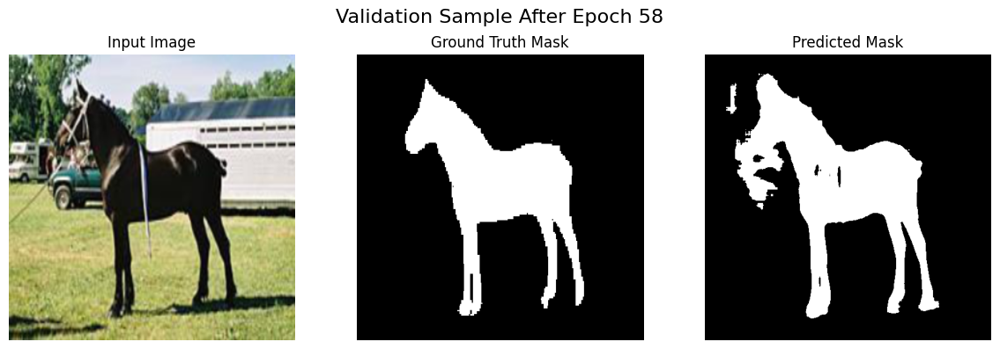


Epoch [59/100]
Train Loss: 0.0628 | IOU: 0.9079 | UOI: 0.0921 | Acc: 0.9755
Precision: 0.9512 | Recall: 0.9525 | F1 Score: 0.9516
Val IOU: 0.7992 | Val UOI: 0.2008 | Val Acc: 0.9475
Val Precision: 0.8861 | Recall: 0.8904 | F1 Score: 0.8867


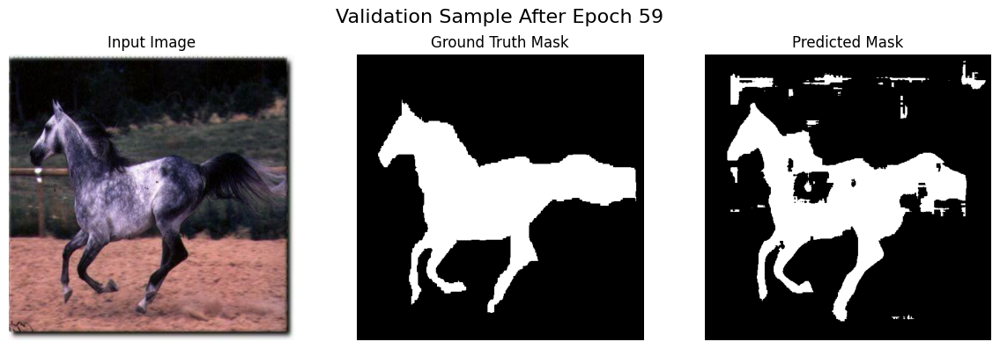

Best model saved.

Epoch [60/100]
Train Loss: 0.0663 | IOU: 0.9020 | UOI: 0.0980 | Acc: 0.9739
Precision: 0.9500 | Recall: 0.9481 | F1 Score: 0.9481
Val IOU: 0.7529 | Val UOI: 0.2471 | Val Acc: 0.9372
Val Precision: 0.9192 | Recall: 0.8076 | F1 Score: 0.8573


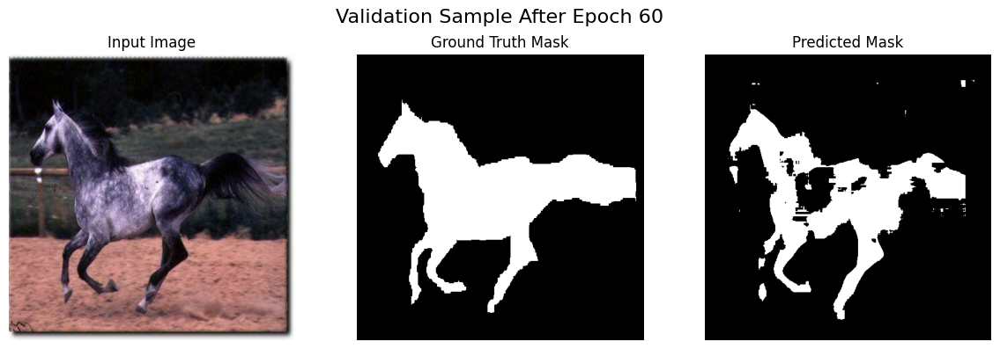


Epoch [61/100]
Train Loss: 0.0608 | IOU: 0.9102 | UOI: 0.0898 | Acc: 0.9762
Precision: 0.9548 | Recall: 0.9516 | F1 Score: 0.9529
Val IOU: 0.7828 | Val UOI: 0.2172 | Val Acc: 0.9418
Val Precision: 0.8735 | Recall: 0.8836 | F1 Score: 0.8767


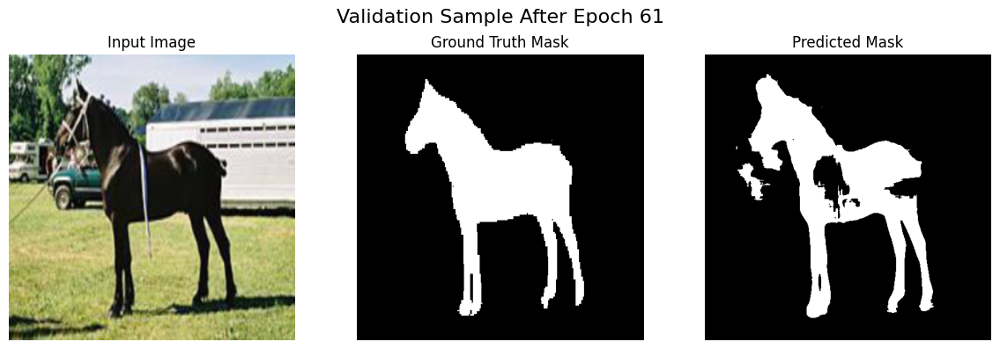


Epoch [62/100]
Train Loss: 0.0475 | IOU: 0.9288 | UOI: 0.0712 | Acc: 0.9814
Precision: 0.9639 | Recall: 0.9623 | F1 Score: 0.9630
Val IOU: 0.8002 | Val UOI: 0.1998 | Val Acc: 0.9477
Val Precision: 0.8873 | Recall: 0.8921 | F1 Score: 0.8872


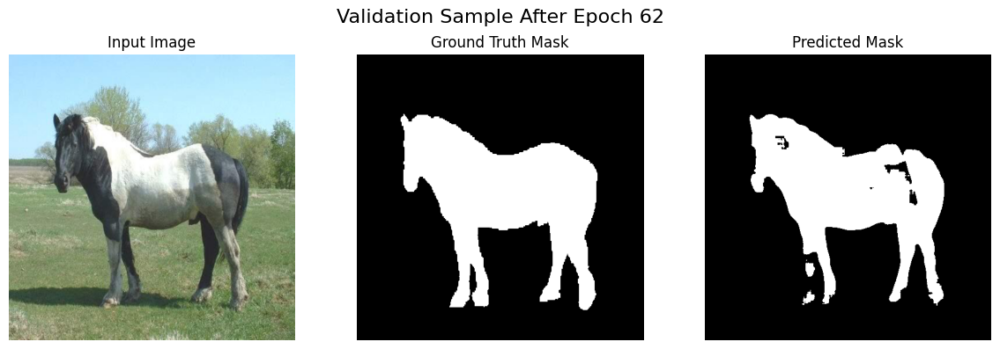

Best model saved.

Epoch [63/100]
Train Loss: 0.0421 | IOU: 0.9361 | UOI: 0.0639 | Acc: 0.9834
Precision: 0.9672 | Recall: 0.9669 | F1 Score: 0.9670
Val IOU: 0.7983 | Val UOI: 0.2017 | Val Acc: 0.9476
Val Precision: 0.8976 | Recall: 0.8799 | F1 Score: 0.8864


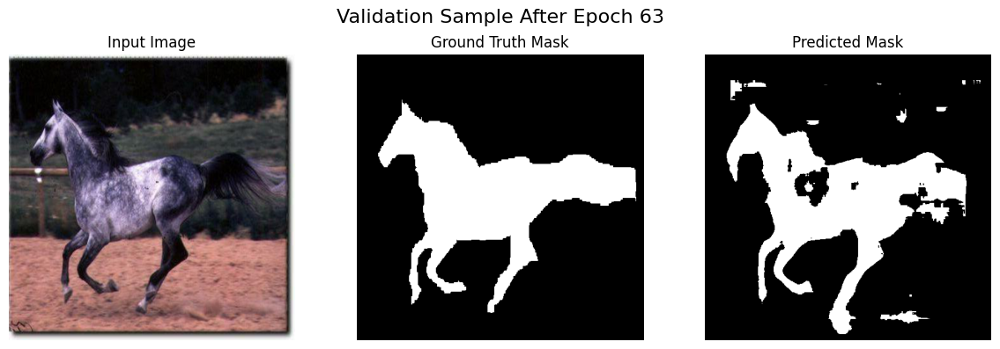


Epoch [64/100]
Train Loss: 0.0392 | IOU: 0.9404 | UOI: 0.0596 | Acc: 0.9845
Precision: 0.9699 | Recall: 0.9687 | F1 Score: 0.9693
Val IOU: 0.7995 | Val UOI: 0.2005 | Val Acc: 0.9467
Val Precision: 0.8792 | Recall: 0.8994 | F1 Score: 0.8868


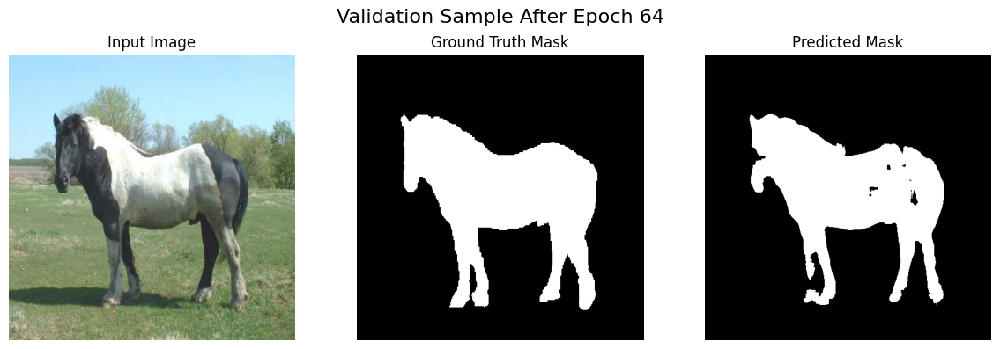


Epoch [65/100]
Train Loss: 0.0389 | IOU: 0.9406 | UOI: 0.0594 | Acc: 0.9845
Precision: 0.9702 | Recall: 0.9687 | F1 Score: 0.9694
Val IOU: 0.7931 | Val UOI: 0.2069 | Val Acc: 0.9444
Val Precision: 0.8712 | Recall: 0.9009 | F1 Score: 0.8826


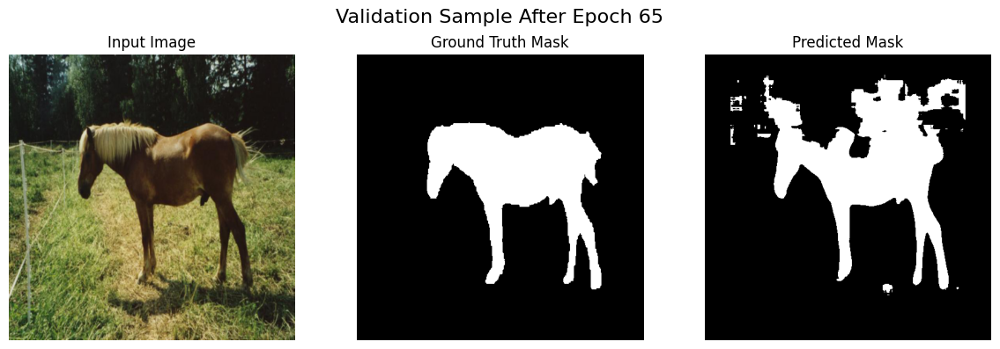


Epoch [66/100]
Train Loss: 0.0383 | IOU: 0.9417 | UOI: 0.0583 | Acc: 0.9848
Precision: 0.9698 | Recall: 0.9702 | F1 Score: 0.9700
Val IOU: 0.8010 | Val UOI: 0.1990 | Val Acc: 0.9471
Val Precision: 0.8826 | Recall: 0.8982 | F1 Score: 0.8880


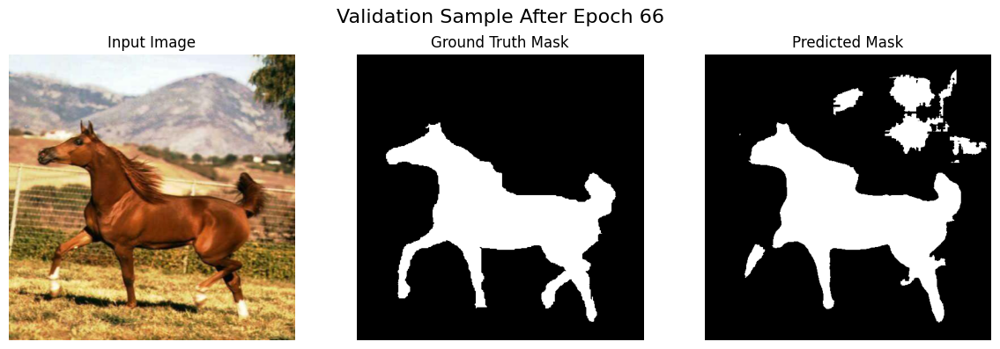

Best model saved.

Epoch [67/100]
Train Loss: 0.0340 | IOU: 0.9474 | UOI: 0.0526 | Acc: 0.9863
Precision: 0.9735 | Recall: 0.9724 | F1 Score: 0.9730
Val IOU: 0.7994 | Val UOI: 0.2006 | Val Acc: 0.9469
Val Precision: 0.8841 | Recall: 0.8956 | F1 Score: 0.8868


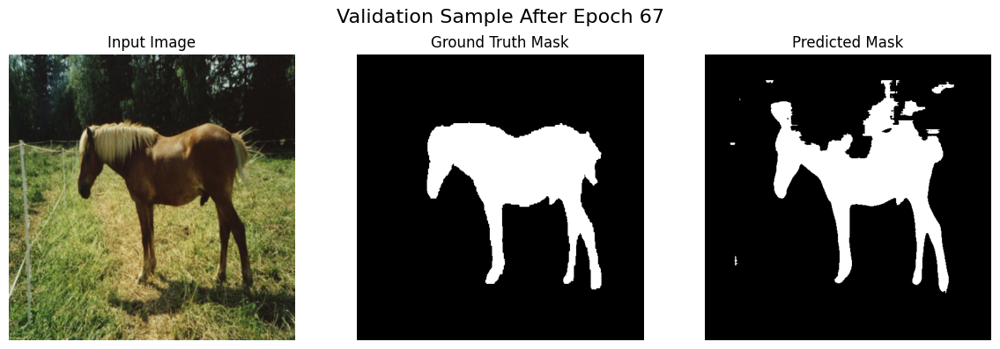


Epoch [68/100]
Train Loss: 0.0323 | IOU: 0.9498 | UOI: 0.0502 | Acc: 0.9869
Precision: 0.9747 | Recall: 0.9739 | F1 Score: 0.9743
Val IOU: 0.8011 | Val UOI: 0.1989 | Val Acc: 0.9474
Val Precision: 0.8836 | Recall: 0.8977 | F1 Score: 0.8880


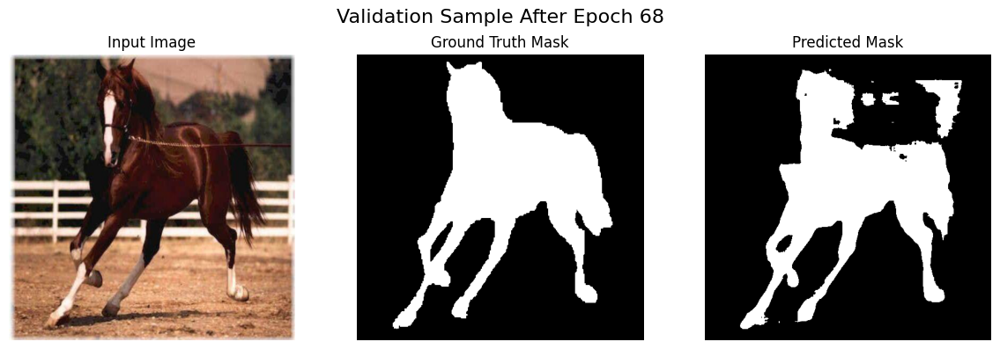

Best model saved.

Epoch [69/100]
Train Loss: 0.0307 | IOU: 0.9518 | UOI: 0.0482 | Acc: 0.9875
Precision: 0.9756 | Recall: 0.9750 | F1 Score: 0.9753
Val IOU: 0.7991 | Val UOI: 0.2009 | Val Acc: 0.9476
Val Precision: 0.8930 | Recall: 0.8856 | F1 Score: 0.8866


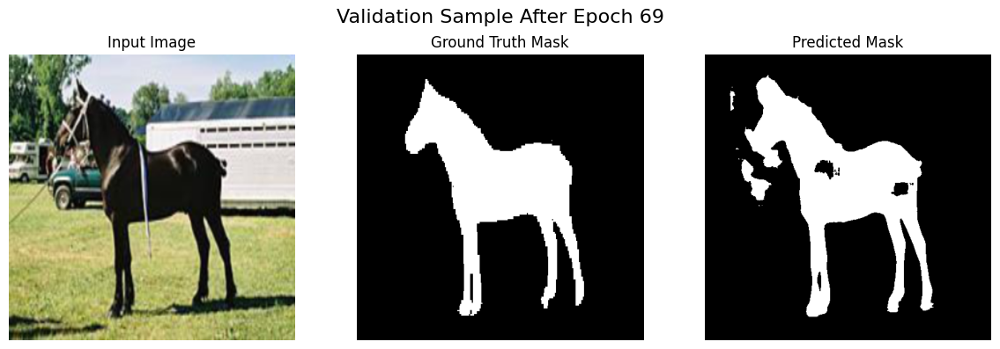


Epoch [70/100]
Train Loss: 0.0304 | IOU: 0.9523 | UOI: 0.0477 | Acc: 0.9877
Precision: 0.9761 | Recall: 0.9751 | F1 Score: 0.9756
Val IOU: 0.8023 | Val UOI: 0.1977 | Val Acc: 0.9483
Val Precision: 0.8927 | Recall: 0.8897 | F1 Score: 0.8887


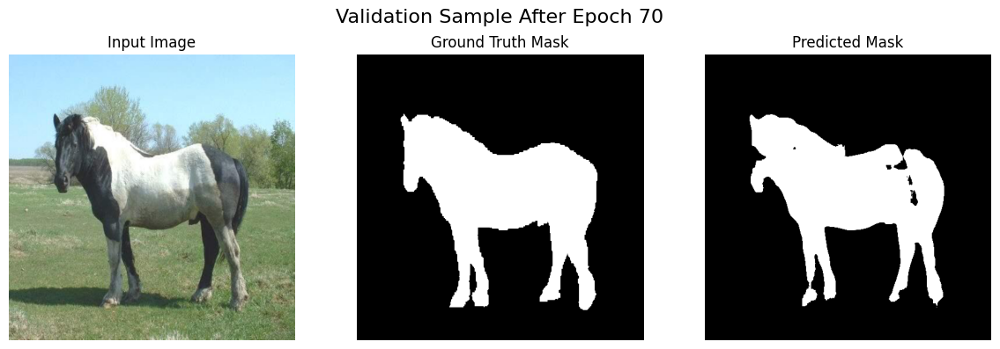

Best model saved.

Epoch [71/100]
Train Loss: 0.0301 | IOU: 0.9527 | UOI: 0.0473 | Acc: 0.9877
Precision: 0.9754 | Recall: 0.9761 | F1 Score: 0.9758
Val IOU: 0.7995 | Val UOI: 0.2005 | Val Acc: 0.9477
Val Precision: 0.8970 | Recall: 0.8814 | F1 Score: 0.8870


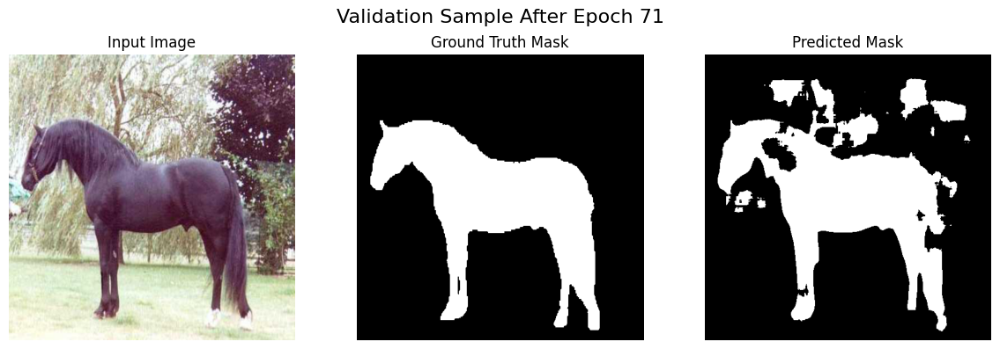


Epoch [72/100]
Train Loss: 0.0301 | IOU: 0.9526 | UOI: 0.0474 | Acc: 0.9877
Precision: 0.9768 | Recall: 0.9747 | F1 Score: 0.9757
Val IOU: 0.7983 | Val UOI: 0.2017 | Val Acc: 0.9466
Val Precision: 0.8846 | Recall: 0.8925 | F1 Score: 0.8862


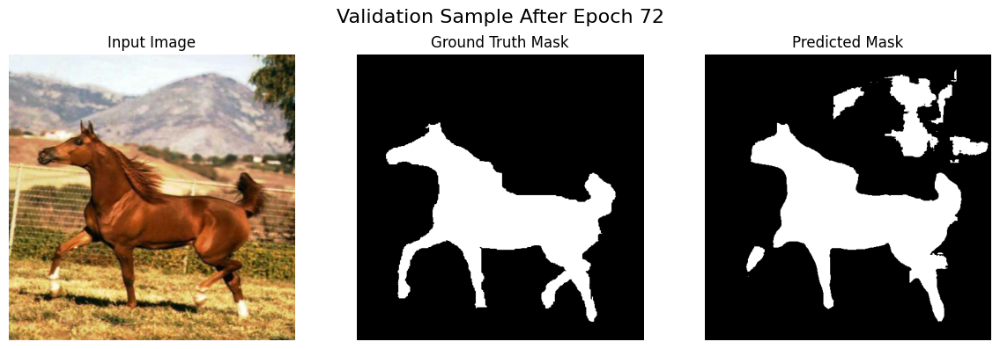


Epoch [73/100]
Train Loss: 0.0279 | IOU: 0.9557 | UOI: 0.0443 | Acc: 0.9885
Precision: 0.9776 | Recall: 0.9771 | F1 Score: 0.9773
Val IOU: 0.7978 | Val UOI: 0.2022 | Val Acc: 0.9468
Val Precision: 0.8831 | Recall: 0.8921 | F1 Score: 0.8858


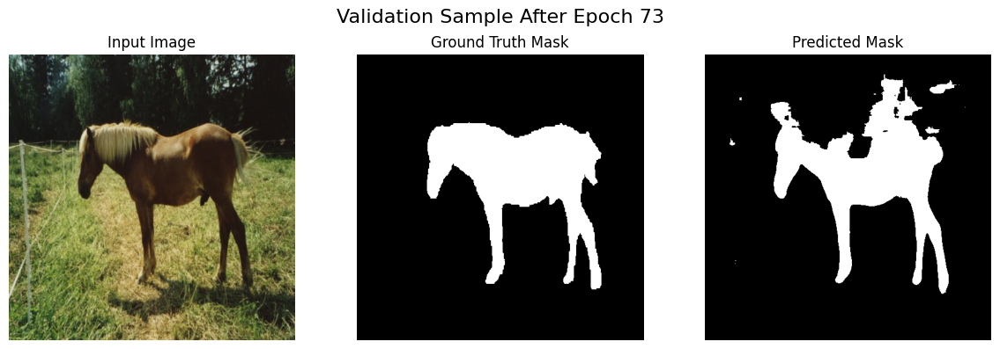


Epoch [74/100]
Train Loss: 0.0265 | IOU: 0.9576 | UOI: 0.0424 | Acc: 0.9891
Precision: 0.9788 | Recall: 0.9780 | F1 Score: 0.9784
Val IOU: 0.8007 | Val UOI: 0.1993 | Val Acc: 0.9475
Val Precision: 0.8875 | Recall: 0.8918 | F1 Score: 0.8878


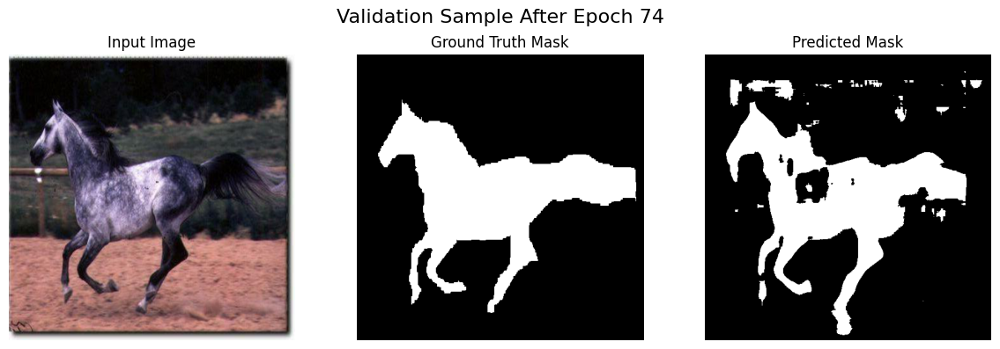


Epoch [75/100]
Train Loss: 0.0257 | IOU: 0.9586 | UOI: 0.0414 | Acc: 0.9893
Precision: 0.9794 | Recall: 0.9782 | F1 Score: 0.9788
Val IOU: 0.7997 | Val UOI: 0.2003 | Val Acc: 0.9469
Val Precision: 0.8822 | Recall: 0.8969 | F1 Score: 0.8871


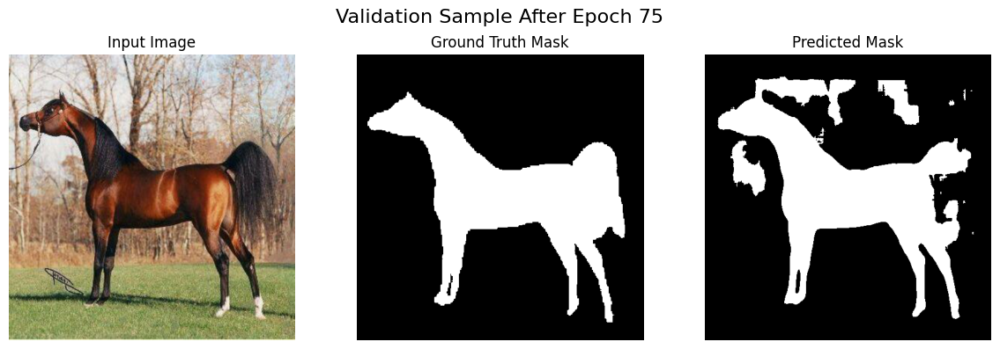


Epoch [76/100]
Train Loss: 0.0253 | IOU: 0.9591 | UOI: 0.0409 | Acc: 0.9895
Precision: 0.9790 | Recall: 0.9793 | F1 Score: 0.9791
Val IOU: 0.8017 | Val UOI: 0.1983 | Val Acc: 0.9473
Val Precision: 0.8805 | Recall: 0.9004 | F1 Score: 0.8883


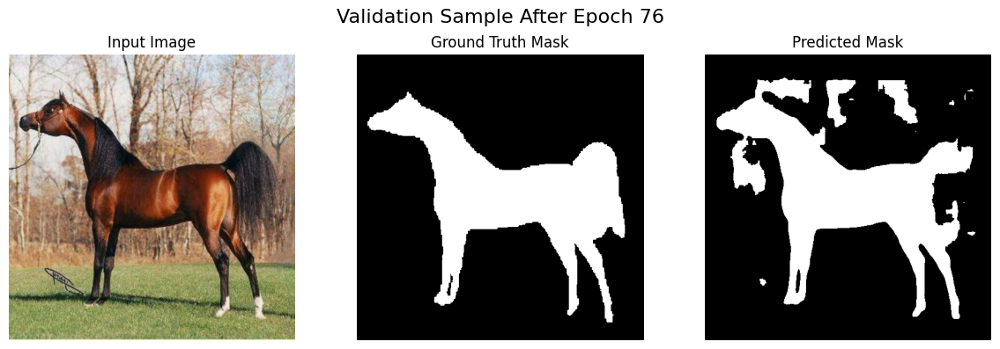


Epoch [77/100]
Train Loss: 0.0256 | IOU: 0.9588 | UOI: 0.0412 | Acc: 0.9894
Precision: 0.9795 | Recall: 0.9785 | F1 Score: 0.9789
Val IOU: 0.8001 | Val UOI: 0.1999 | Val Acc: 0.9476
Val Precision: 0.8888 | Recall: 0.8903 | F1 Score: 0.8871


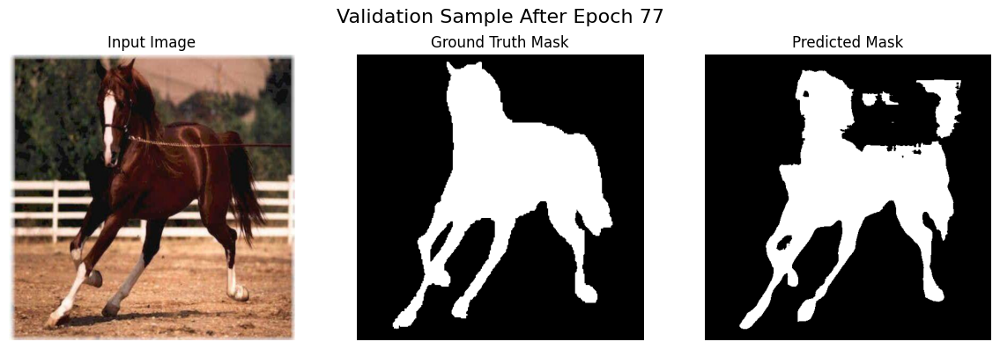


Epoch [78/100]
Train Loss: 0.0248 | IOU: 0.9601 | UOI: 0.0399 | Acc: 0.9897
Precision: 0.9797 | Recall: 0.9796 | F1 Score: 0.9796
Val IOU: 0.8001 | Val UOI: 0.1999 | Val Acc: 0.9476
Val Precision: 0.8919 | Recall: 0.8877 | F1 Score: 0.8872


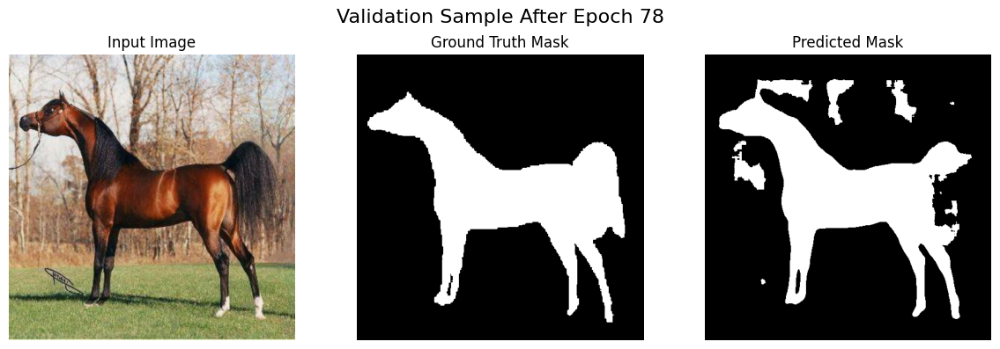


Epoch [79/100]
Train Loss: 0.0234 | IOU: 0.9620 | UOI: 0.0380 | Acc: 0.9902
Precision: 0.9812 | Recall: 0.9801 | F1 Score: 0.9806
Val IOU: 0.8021 | Val UOI: 0.1979 | Val Acc: 0.9479
Val Precision: 0.8877 | Recall: 0.8939 | F1 Score: 0.8887


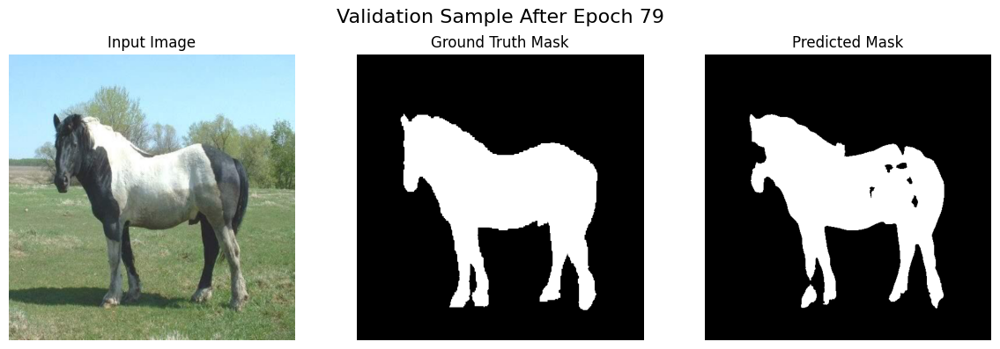


Epoch [80/100]
Train Loss: 0.0241 | IOU: 0.9612 | UOI: 0.0388 | Acc: 0.9900
Precision: 0.9802 | Recall: 0.9802 | F1 Score: 0.9802
Val IOU: 0.7975 | Val UOI: 0.2025 | Val Acc: 0.9471
Val Precision: 0.8891 | Recall: 0.8864 | F1 Score: 0.8853


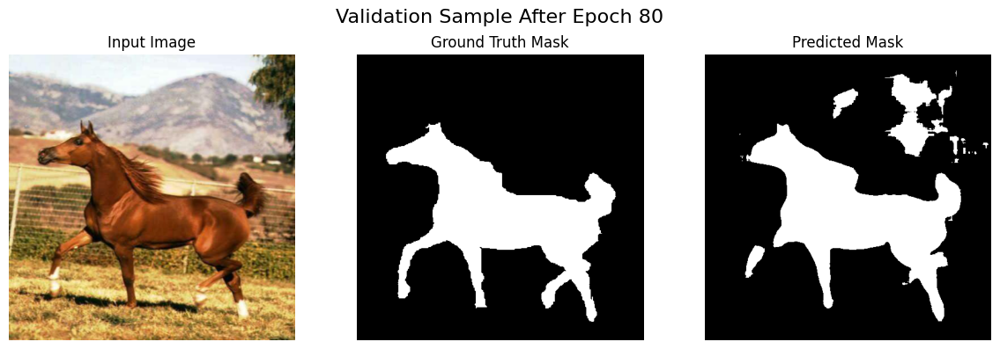


Epoch [81/100]
Train Loss: 0.0237 | IOU: 0.9618 | UOI: 0.0382 | Acc: 0.9901
Precision: 0.9806 | Recall: 0.9804 | F1 Score: 0.9805
Val IOU: 0.7973 | Val UOI: 0.2027 | Val Acc: 0.9469
Val Precision: 0.8932 | Recall: 0.8823 | F1 Score: 0.8857


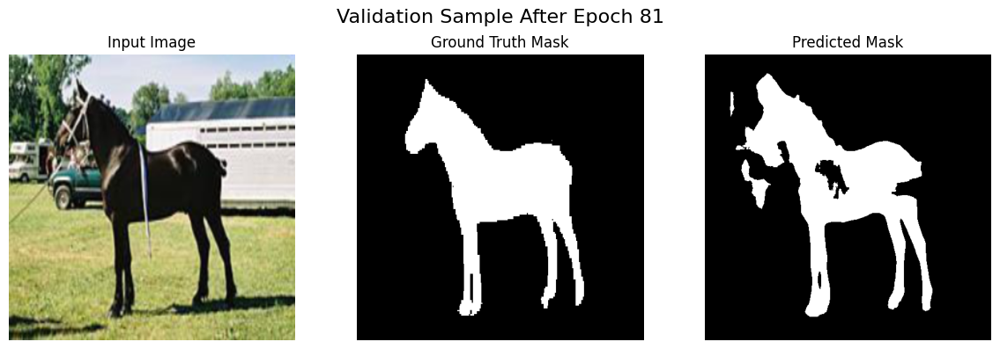


Epoch [82/100]
Train Loss: 0.0223 | IOU: 0.9636 | UOI: 0.0364 | Acc: 0.9907
Precision: 0.9824 | Recall: 0.9806 | F1 Score: 0.9815
Val IOU: 0.8021 | Val UOI: 0.1979 | Val Acc: 0.9478
Val Precision: 0.8877 | Recall: 0.8940 | F1 Score: 0.8885


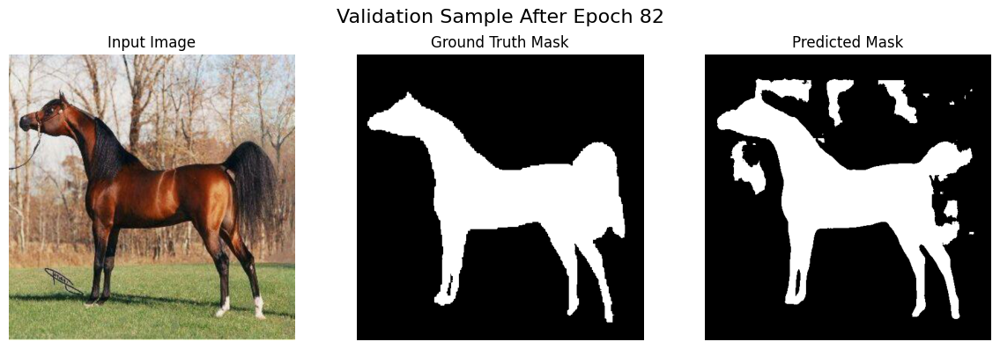


Epoch [83/100]
Train Loss: 0.0215 | IOU: 0.9648 | UOI: 0.0352 | Acc: 0.9910
Precision: 0.9821 | Recall: 0.9821 | F1 Score: 0.9821
Val IOU: 0.8019 | Val UOI: 0.1981 | Val Acc: 0.9477
Val Precision: 0.8858 | Recall: 0.8958 | F1 Score: 0.8884


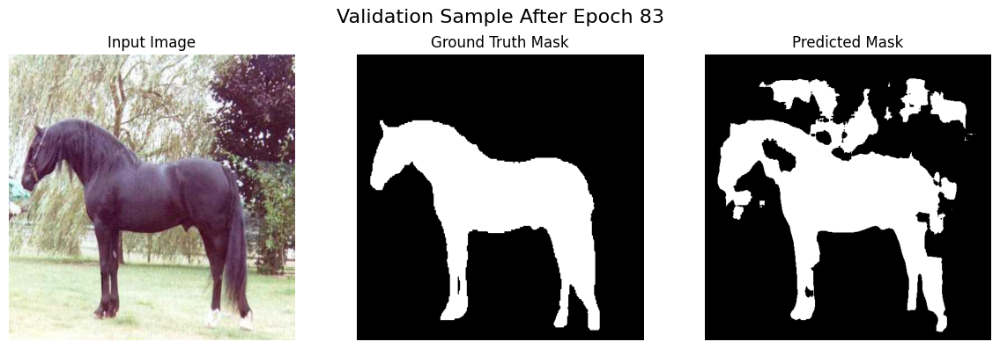


Epoch [84/100]
Train Loss: 0.0211 | IOU: 0.9653 | UOI: 0.0347 | Acc: 0.9911
Precision: 0.9825 | Recall: 0.9822 | F1 Score: 0.9824
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9478
Val Precision: 0.8862 | Recall: 0.8954 | F1 Score: 0.8884


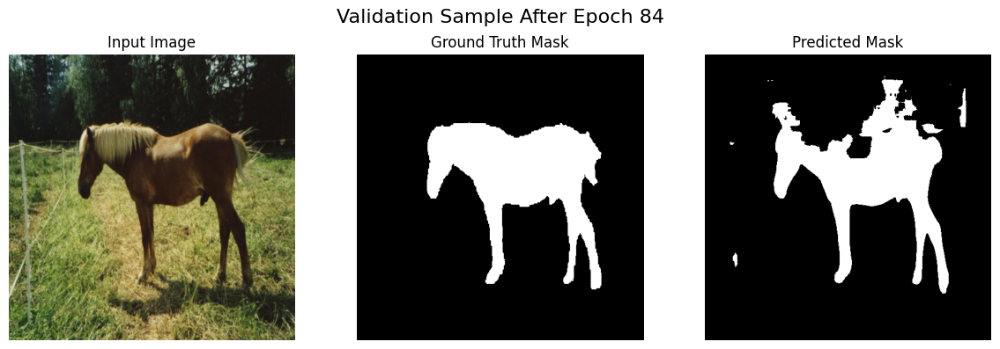


Epoch [85/100]
Train Loss: 0.0209 | IOU: 0.9657 | UOI: 0.0343 | Acc: 0.9912
Precision: 0.9828 | Recall: 0.9823 | F1 Score: 0.9825
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9476
Val Precision: 0.8847 | Recall: 0.8971 | F1 Score: 0.8885


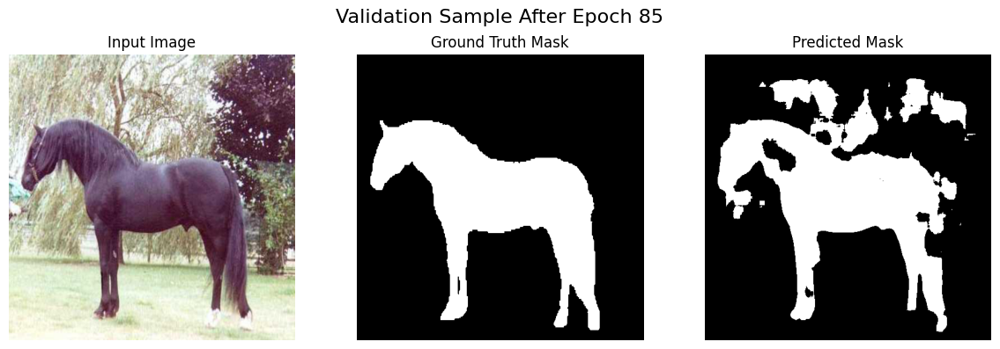


Epoch [86/100]
Train Loss: 0.0208 | IOU: 0.9659 | UOI: 0.0341 | Acc: 0.9912
Precision: 0.9828 | Recall: 0.9825 | F1 Score: 0.9826
Val IOU: 0.8022 | Val UOI: 0.1978 | Val Acc: 0.9477
Val Precision: 0.8857 | Recall: 0.8965 | F1 Score: 0.8886


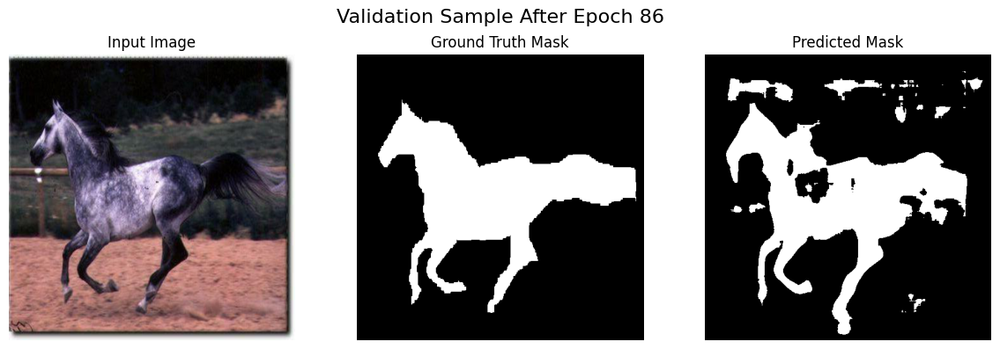


Epoch [87/100]
Train Loss: 0.0206 | IOU: 0.9662 | UOI: 0.0338 | Acc: 0.9913
Precision: 0.9826 | Recall: 0.9830 | F1 Score: 0.9828
Val IOU: 0.8018 | Val UOI: 0.1982 | Val Acc: 0.9478
Val Precision: 0.8882 | Recall: 0.8934 | F1 Score: 0.8883


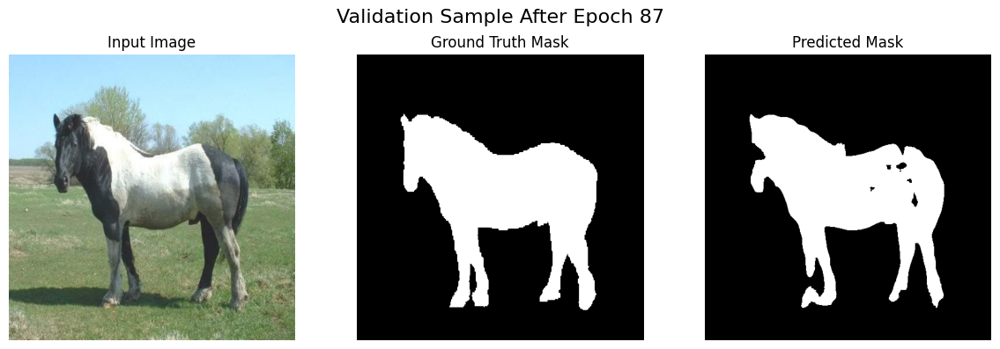


Epoch [88/100]
Train Loss: 0.0206 | IOU: 0.9662 | UOI: 0.0338 | Acc: 0.9913
Precision: 0.9830 | Recall: 0.9826 | F1 Score: 0.9828
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9477
Val Precision: 0.8857 | Recall: 0.8961 | F1 Score: 0.8885


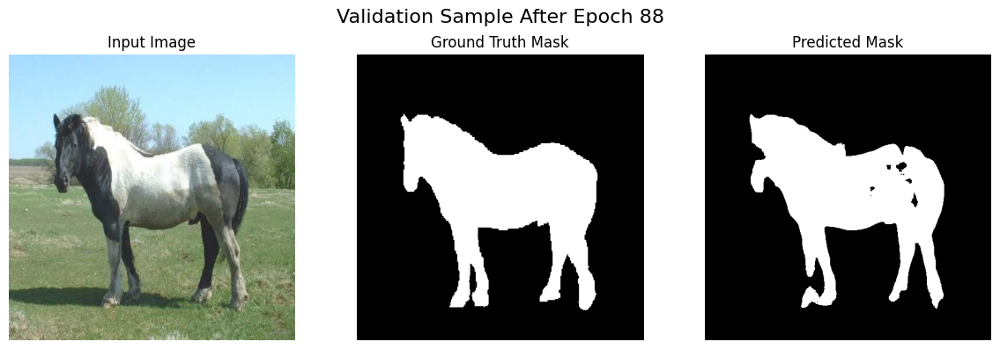


Epoch [89/100]
Train Loss: 0.0205 | IOU: 0.9662 | UOI: 0.0338 | Acc: 0.9913
Precision: 0.9829 | Recall: 0.9827 | F1 Score: 0.9828
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9478
Val Precision: 0.8869 | Recall: 0.8950 | F1 Score: 0.8885


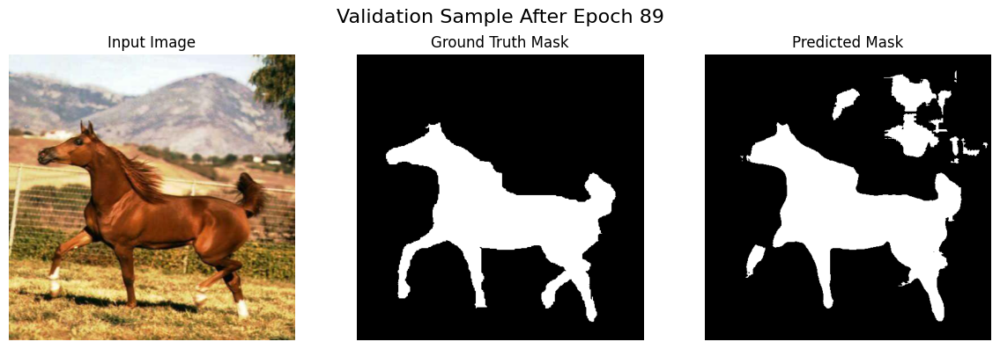


Epoch [90/100]
Train Loss: 0.0205 | IOU: 0.9662 | UOI: 0.0338 | Acc: 0.9913
Precision: 0.9828 | Recall: 0.9828 | F1 Score: 0.9828
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9477
Val Precision: 0.8859 | Recall: 0.8961 | F1 Score: 0.8884


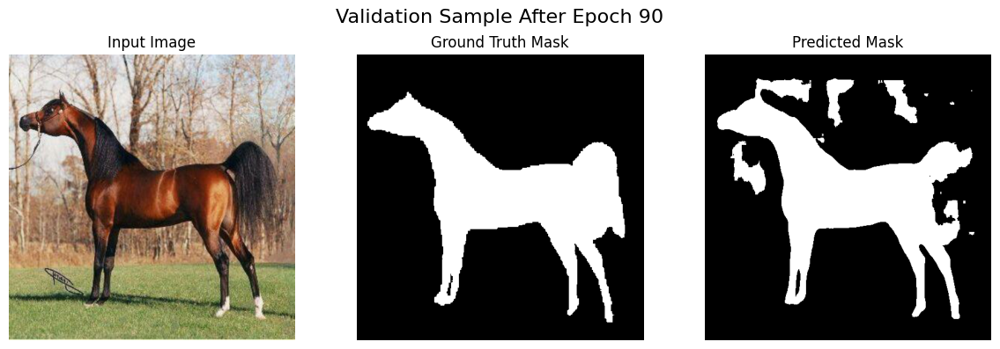


Epoch [91/100]
Train Loss: 0.0203 | IOU: 0.9665 | UOI: 0.0335 | Acc: 0.9914
Precision: 0.9829 | Recall: 0.9830 | F1 Score: 0.9830
Val IOU: 0.8019 | Val UOI: 0.1981 | Val Acc: 0.9477
Val Precision: 0.8864 | Recall: 0.8952 | F1 Score: 0.8884


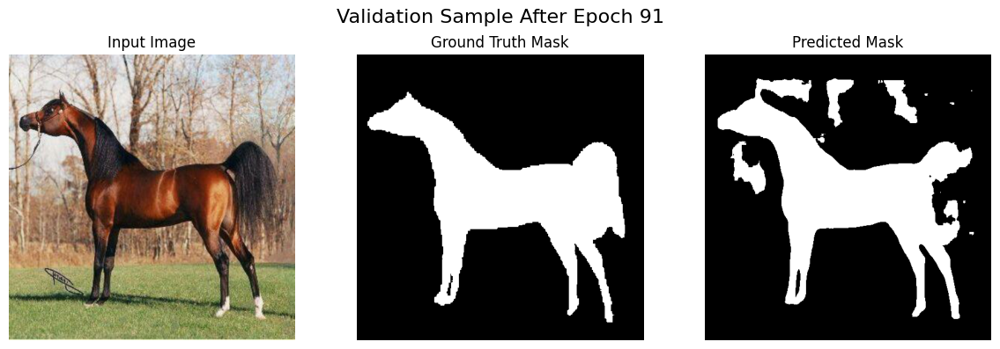


Epoch [92/100]
Train Loss: 0.0203 | IOU: 0.9667 | UOI: 0.0333 | Acc: 0.9914
Precision: 0.9831 | Recall: 0.9830 | F1 Score: 0.9831
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9478
Val Precision: 0.8869 | Recall: 0.8949 | F1 Score: 0.8885


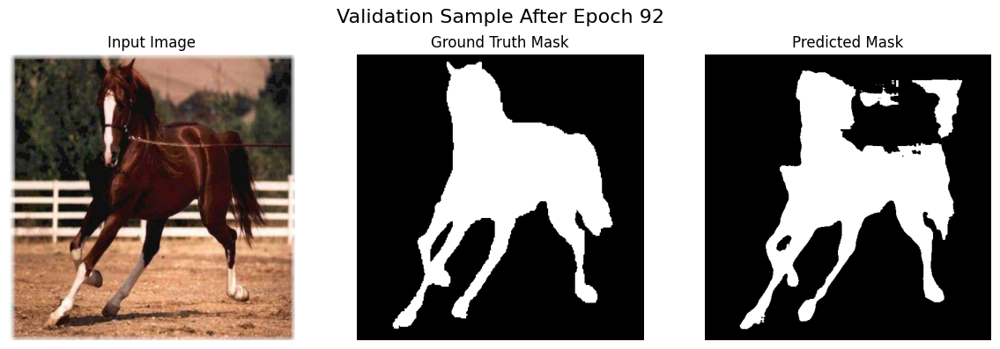


Epoch [93/100]
Train Loss: 0.0202 | IOU: 0.9667 | UOI: 0.0333 | Acc: 0.9914
Precision: 0.9832 | Recall: 0.9829 | F1 Score: 0.9830
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9478
Val Precision: 0.8867 | Recall: 0.8952 | F1 Score: 0.8885


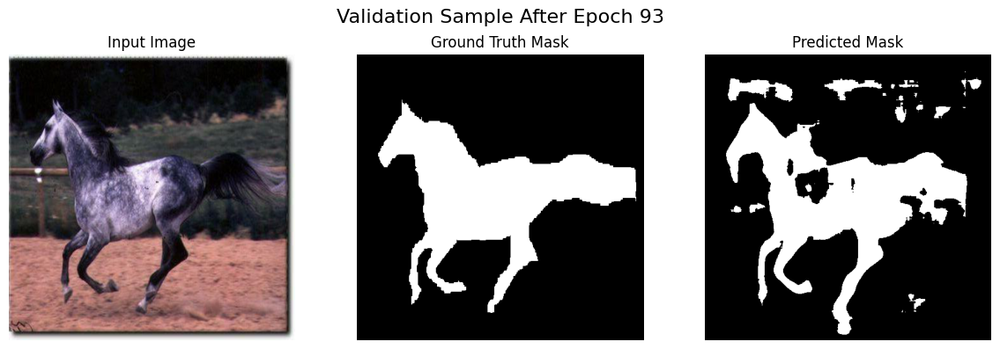


Epoch [94/100]
Train Loss: 0.0201 | IOU: 0.9668 | UOI: 0.0332 | Acc: 0.9915
Precision: 0.9832 | Recall: 0.9831 | F1 Score: 0.9831
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9477
Val Precision: 0.8864 | Recall: 0.8954 | F1 Score: 0.8885


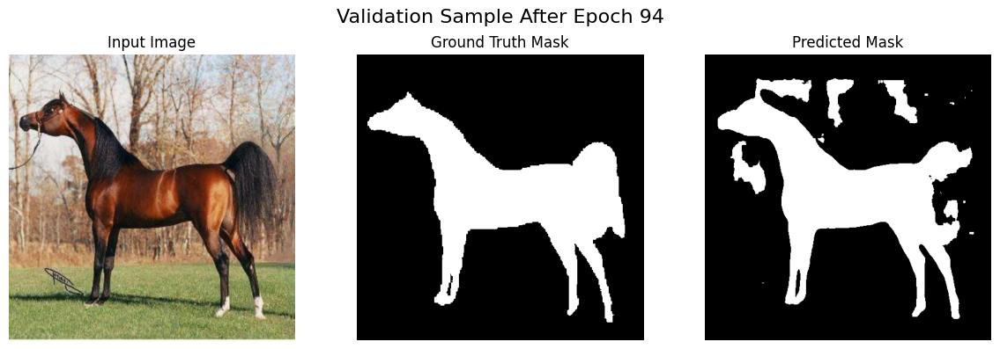


Epoch [95/100]
Train Loss: 0.0202 | IOU: 0.9667 | UOI: 0.0333 | Acc: 0.9915
Precision: 0.9833 | Recall: 0.9829 | F1 Score: 0.9831
Val IOU: 0.8020 | Val UOI: 0.1980 | Val Acc: 0.9477
Val Precision: 0.8865 | Recall: 0.8952 | F1 Score: 0.8884


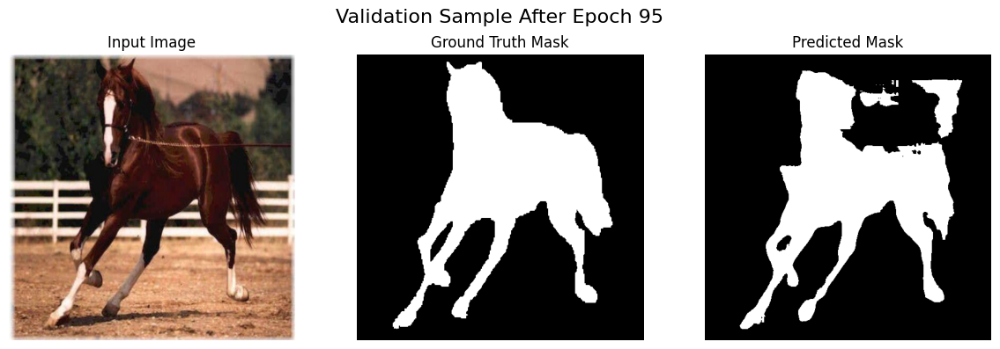


Epoch [96/100]
Train Loss: 0.0200 | IOU: 0.9670 | UOI: 0.0330 | Acc: 0.9915
Precision: 0.9832 | Recall: 0.9833 | F1 Score: 0.9832
Val IOU: 0.8019 | Val UOI: 0.1981 | Val Acc: 0.9477
Val Precision: 0.8867 | Recall: 0.8949 | F1 Score: 0.8884


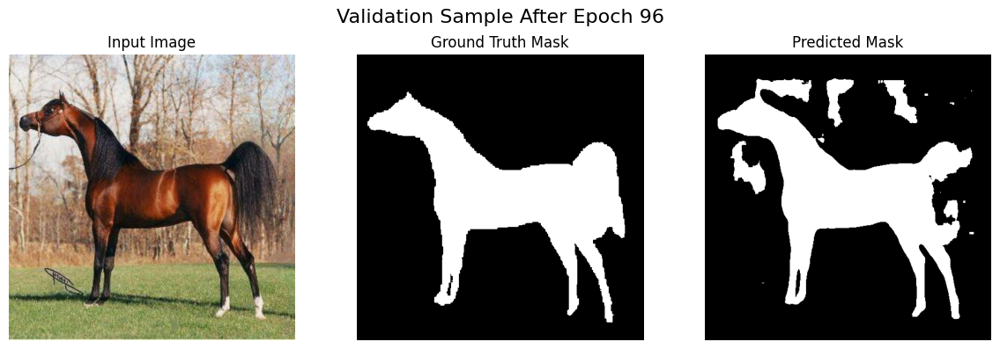


Epoch [97/100]
Train Loss: 0.0201 | IOU: 0.9669 | UOI: 0.0331 | Acc: 0.9915
Precision: 0.9834 | Recall: 0.9830 | F1 Score: 0.9832
Val IOU: 0.8019 | Val UOI: 0.1981 | Val Acc: 0.9478
Val Precision: 0.8868 | Recall: 0.8948 | F1 Score: 0.8884


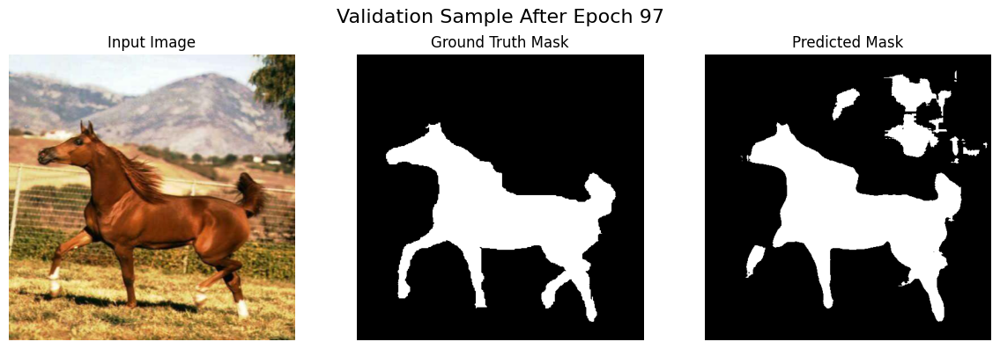


Epoch [98/100]
Train Loss: 0.0201 | IOU: 0.9669 | UOI: 0.0331 | Acc: 0.9915
Precision: 0.9831 | Recall: 0.9833 | F1 Score: 0.9832
Val IOU: 0.8019 | Val UOI: 0.1981 | Val Acc: 0.9477
Val Precision: 0.8866 | Recall: 0.8950 | F1 Score: 0.8884


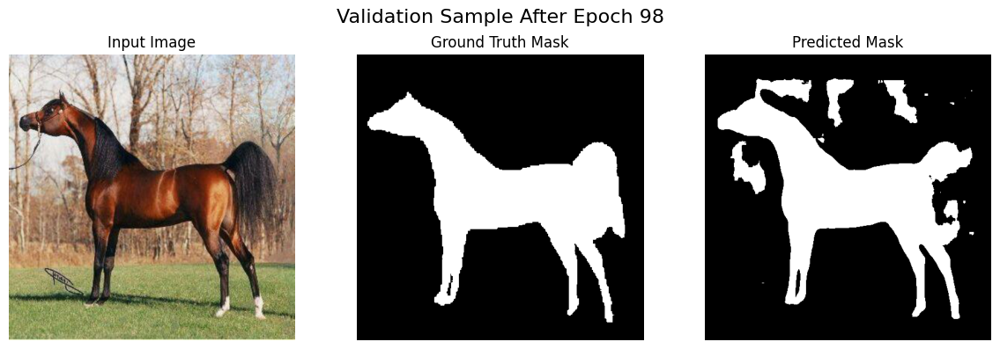


Epoch [99/100]
Train Loss: 0.0200 | IOU: 0.9668 | UOI: 0.0332 | Acc: 0.9915
Precision: 0.9832 | Recall: 0.9831 | F1 Score: 0.9831
Val IOU: 0.8017 | Val UOI: 0.1983 | Val Acc: 0.9477
Val Precision: 0.8871 | Recall: 0.8944 | F1 Score: 0.8883


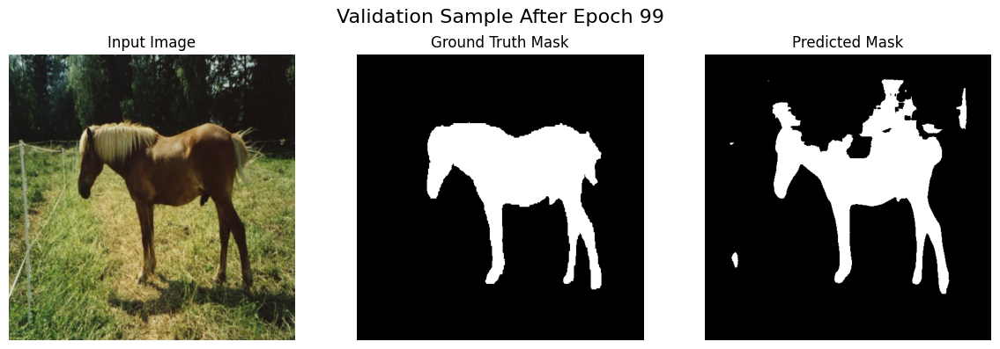


Epoch [100/100]
Train Loss: 0.0201 | IOU: 0.9669 | UOI: 0.0331 | Acc: 0.9915
Precision: 0.9834 | Recall: 0.9829 | F1 Score: 0.9832
Val IOU: 0.8018 | Val UOI: 0.1982 | Val Acc: 0.9477
Val Precision: 0.8865 | Recall: 0.8951 | F1 Score: 0.8883


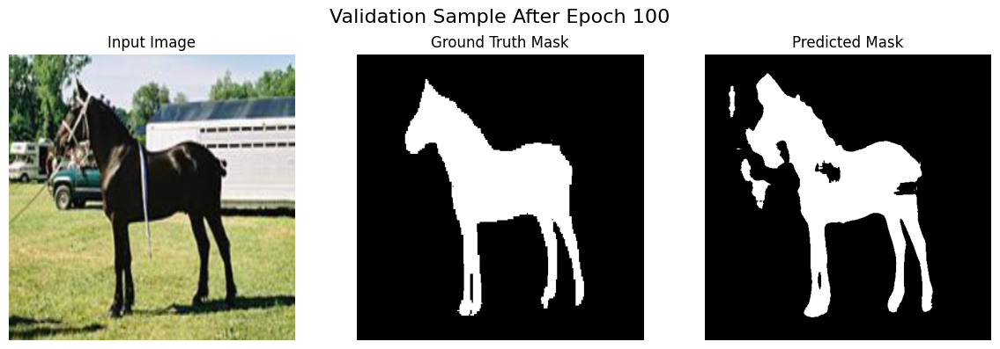

In [5]:
# === Helper Functions ===
def flatten_preds_and_masks(preds, masks):
    preds = preds.view(-1).cpu().numpy().astype(int)
    masks = masks.view(-1).cpu().numpy().astype(int)
    return preds, masks

def compute_iou(preds, masks):
    preds, masks = flatten_preds_and_masks(preds, masks)
    return jaccard_score(masks, preds, average='binary', zero_division=0)

def compute_accuracy(preds, masks):
    preds, masks = flatten_preds_and_masks(preds, masks)
    correct = (preds == masks).sum()
    return correct / len(masks)

def compute_precision(preds, masks):
    preds, masks = flatten_preds_and_masks(preds, masks)
    return precision_score(masks, preds, zero_division=0)

def compute_recall(preds, masks):
    preds, masks = flatten_preds_and_masks(preds, masks)
    return recall_score(masks, preds, zero_division=0)

def compute_f1(preds, masks):
    preds, masks = flatten_preds_and_masks(preds, masks)
    return f1_score(masks, preds, zero_division=0)

# === Model, Optimizer, Scheduler ===
model = UNet(in_channels=3, out_channels=1, k=200).to(DEVICE)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'max', patience=10, factor=0.1)

best_iou = 0.0

# === History Dictionary Updated ===
history = {
    'train_loss': [],
    'train_iou': [],
    'train_acc': [],
    'train_precision': [],
    'train_recall': [],
    'train_f1': [],
    'val_iou': [],
    'val_acc': [],
    'val_precision': [],
    'val_recall': [],
    'val_f1': [],
}

# === Training Loop ===
for epoch in range(NUM_EPOCHS):
    model.train()
    running_loss = 0.0
    train_iou = train_acc = train_precision = train_recall = train_f1 = 0.0
    n_batches = 0

    for inputs, masks in train_loader:
        inputs, masks = inputs.to(DEVICE), masks.to(DEVICE)
        optimizer.zero_grad()
        outputs, *_ = model(inputs)
        outputs = torch.sigmoid(outputs)

        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        preds = (outputs > 0.5).float()

        train_iou += compute_iou(preds, masks)
        train_acc += compute_accuracy(preds, masks)
        train_precision += compute_precision(preds, masks)
        train_recall += compute_recall(preds, masks)
        train_f1 += compute_f1(preds, masks)

        n_batches += 1

    avg_loss = running_loss / n_batches
    avg_iou = train_iou / n_batches
    avg_acc = train_acc / n_batches
    avg_precision = train_precision / n_batches
    avg_recall = train_recall / n_batches
    avg_f1 = train_f1 / n_batches
    uoi = 1 - avg_iou

    print(f"\nEpoch [{epoch+1}/{NUM_EPOCHS}]")
    print(f"Train Loss: {avg_loss:.4f} | IOU: {avg_iou:.4f} | UOI: {uoi:.4f} | Acc: {avg_acc:.4f}")
    print(f"Precision: {avg_precision:.4f} | Recall: {avg_recall:.4f} | F1 Score: {avg_f1:.4f}")

    # === Validation ===
    model.eval()
    val_iou = val_acc = val_precision = val_recall = val_f1 = 0.0
    val_batches = 0
    val_examples = []

    with torch.no_grad():
        for inputs, masks in val_loader:
            inputs, masks = inputs.to(DEVICE), masks.to(DEVICE)
            outputs, *_ = model(inputs)
            outputs = torch.sigmoid(outputs)
            preds = (outputs > 0.5).float()

            val_iou += compute_iou(preds, masks)
            val_acc += compute_accuracy(preds, masks)
            val_precision += compute_precision(preds, masks)
            val_recall += compute_recall(preds, masks)
            val_f1 += compute_f1(preds, masks)
            val_batches += 1

            if len(val_examples) == 0:
                rand_idx = random.randint(0, inputs.size(0) - 1)
                val_examples.append((
                    inputs[rand_idx].unsqueeze(0).cpu(),
                    masks[rand_idx].unsqueeze(0).cpu(),
                    preds[rand_idx].unsqueeze(0).cpu()
                ))

    avg_val_iou = val_iou / val_batches
    avg_val_acc = val_acc / val_batches
    avg_val_precision = val_precision / val_batches
    avg_val_recall = val_recall / val_batches
    avg_val_f1 = val_f1 / val_batches
    val_uoi = 1 - avg_val_iou

    print(f"Val IOU: {avg_val_iou:.4f} | Val UOI: {val_uoi:.4f} | Val Acc: {avg_val_acc:.4f}")
    print(f"Val Precision: {avg_val_precision:.4f} | Recall: {avg_val_recall:.4f} | F1 Score: {avg_val_f1:.4f}")

    # === Save History ===
    history['train_loss'].append(avg_loss)
    history['train_iou'].append(avg_iou)
    history['train_acc'].append(avg_acc)
    history['train_precision'].append(avg_precision)
    history['train_recall'].append(avg_recall)
    history['train_f1'].append(avg_f1)
    history['val_iou'].append(avg_val_iou)
    history['val_acc'].append(avg_val_acc)
    history['val_precision'].append(avg_val_precision)
    history['val_recall'].append(avg_val_recall)
    history['val_f1'].append(avg_val_f1)

    # === Visualize Predictions ===
    if len(val_examples) > 0:
        inp, true_mask, pred_mask = val_examples[0]
        inp = inp[0].permute(1, 2, 0)
        true_mask = true_mask[0].squeeze(0)
        pred_mask = pred_mask[0].squeeze(0)

        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(inp)
        plt.title("Input Image")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(true_mask, cmap='gray')
        plt.title("Ground Truth Mask")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(pred_mask, cmap='gray')
        plt.title("Predicted Mask")
        plt.axis('off')

        plt.tight_layout()
        plt.suptitle(f"Validation Sample After Epoch {epoch+1}", fontsize=16)
        plt.subplots_adjust(top=0.85)
        plt.show()


    # === Learning Rate Scheduler ===
    scheduler.step(avg_val_iou)

    # === Save Best Model ===
    if avg_val_iou > best_iou:
        best_iou = avg_val_iou
        torch.save(model.state_dict(), "best_model.pth")
        print("Best model saved.")


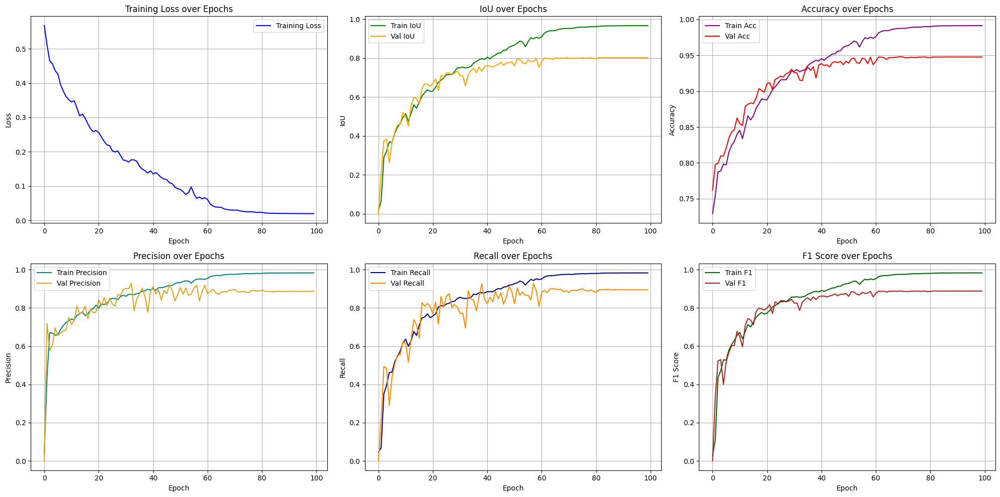

In [6]:
# === PLOT TRAINING HISTORY WITH NEW METRICS ===
fig, axes = plt.subplots(2, 3, figsize=(20, 10))

# Plot training loss
axes[0, 0].plot(history['train_loss'], label='Training Loss', color='blue')
axes[0, 0].set_title('Training Loss over Epochs')
axes[0, 0].set_xlabel('Epoch')
axes[0, 0].set_ylabel('Loss')
axes[0, 0].legend()
axes[0, 0].grid(True)

# Plot IoU
axes[0, 1].plot(history['train_iou'], label='Train IoU', color='green')
axes[0, 1].plot(history['val_iou'], label='Val IoU', color='orange')
axes[0, 1].set_title('IoU over Epochs')
axes[0, 1].set_xlabel('Epoch')
axes[0, 1].set_ylabel('IoU')
axes[0, 1].legend()
axes[0, 1].grid(True)

# Plot Accuracy
axes[0, 2].plot(history['train_acc'], label='Train Acc', color='purple')
axes[0, 2].plot(history['val_acc'], label='Val Acc', color='red')
axes[0, 2].set_title('Accuracy over Epochs')
axes[0, 2].set_xlabel('Epoch')
axes[0, 2].set_ylabel('Accuracy')
axes[0, 2].legend()
axes[0, 2].grid(True)

# Plot Precision
axes[1, 0].plot(history['train_precision'], label='Train Precision', color='teal')
axes[1, 0].plot(history['val_precision'], label='Val Precision', color='goldenrod')
axes[1, 0].set_title('Precision over Epochs')
axes[1, 0].set_xlabel('Epoch')
axes[1, 0].set_ylabel('Precision')
axes[1, 0].legend()
axes[1, 0].grid(True)

# Plot Recall
axes[1, 1].plot(history['train_recall'], label='Train Recall', color='navy')
axes[1, 1].plot(history['val_recall'], label='Val Recall', color='darkorange')
axes[1, 1].set_title('Recall over Epochs')
axes[1, 1].set_xlabel('Epoch')
axes[1, 1].set_ylabel('Recall')
axes[1, 1].legend()
axes[1, 1].grid(True)

# Plot F1 Score
axes[1, 2].plot(history['train_f1'], label='Train F1', color='darkgreen')
axes[1, 2].plot(history['val_f1'], label='Val F1', color='firebrick')
axes[1, 2].set_title('F1 Score over Epochs')
axes[1, 2].set_xlabel('Epoch')
axes[1, 2].set_ylabel('F1 Score')
axes[1, 2].legend()
axes[1, 2].grid(True)

plt.tight_layout()
plt.show()




--- Visualizing Model Predictions ---


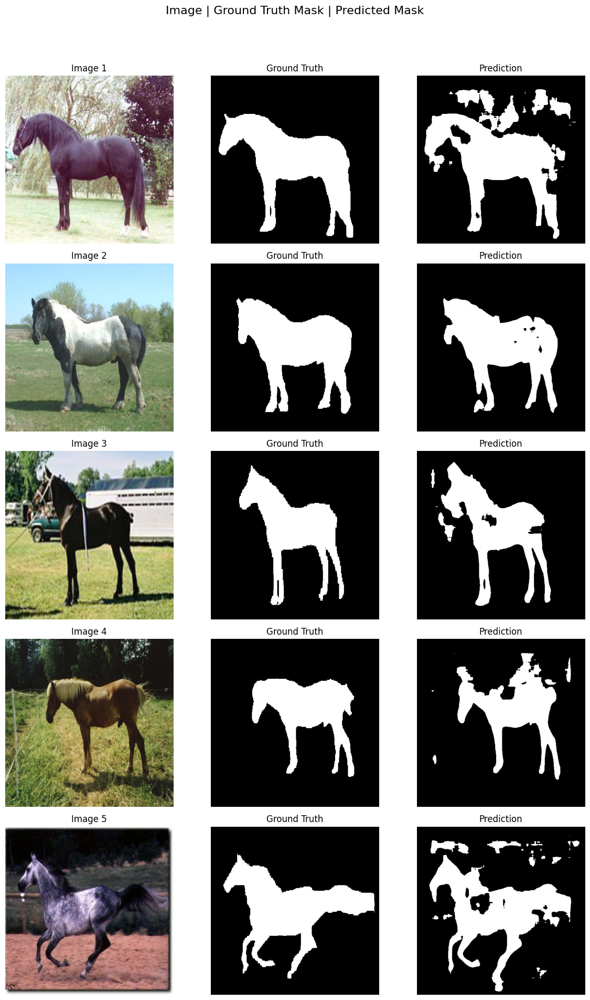

In [7]:
# === VISUALIZE PREDICTIONS ON VALIDATION SET ===
def visualize_predictions(model, loader, device, num_images=5):
    """
    Shows model predictions on a few validation images.
    """
    print("\n--- Visualizing Model Predictions ---")
    model.eval()

    images, masks = next(iter(loader))
    images = images.to(device)
    masks = masks.to(device)

    with torch.no_grad():
        outputs, *_ = model(images)
        preds = torch.sigmoid(outputs)
        preds = (preds > 0.5).float()

    fig, axes = plt.subplots(num_images, 3, figsize=(12, num_images * 4))
    fig.suptitle('Image | Ground Truth Mask | Predicted Mask', fontsize=16)

    for i in range(num_images):
        if i >= len(images):
            break

        # Original Image
        axes[i, 0].imshow(images[i].cpu().permute(1, 2, 0))
        axes[i, 0].set_title(f"Image {i+1}")
        axes[i, 0].axis('off')

        # Ground Truth
        axes[i, 1].imshow(masks[i].squeeze().cpu(), cmap='gray')
        axes[i, 1].set_title("Ground Truth")
        axes[i, 1].axis('off')

        # Prediction
        axes[i, 2].imshow(preds[i].squeeze().cpu(), cmap='gray')
        axes[i, 2].set_title("Prediction")
        axes[i, 2].axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

visualize_predictions(model, val_loader, device=DEVICE, num_images=5)



🔍 Running Seg-Grad-CAM on sample 1


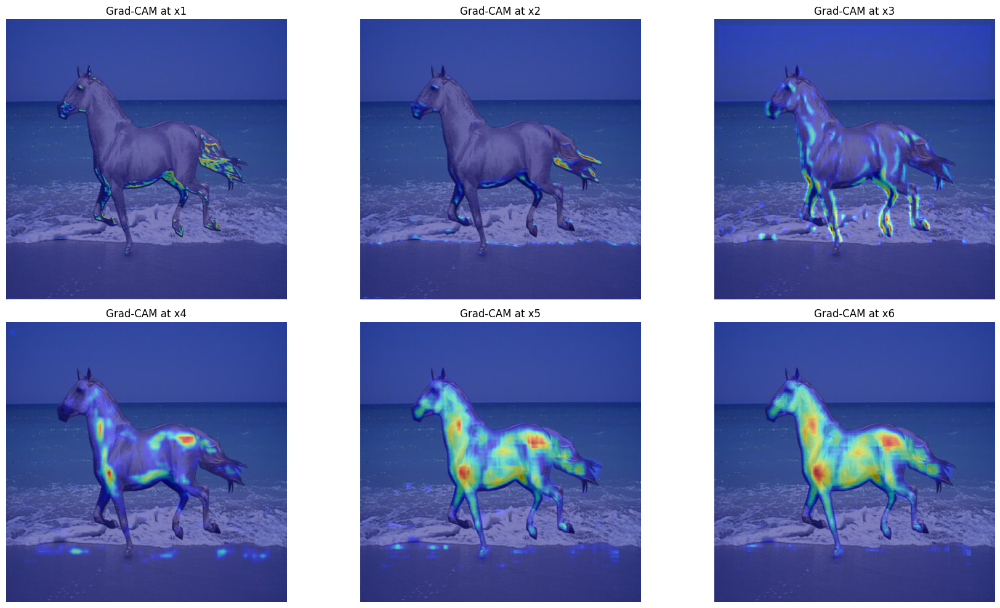


🔍 Running Seg-Grad-CAM on sample 2


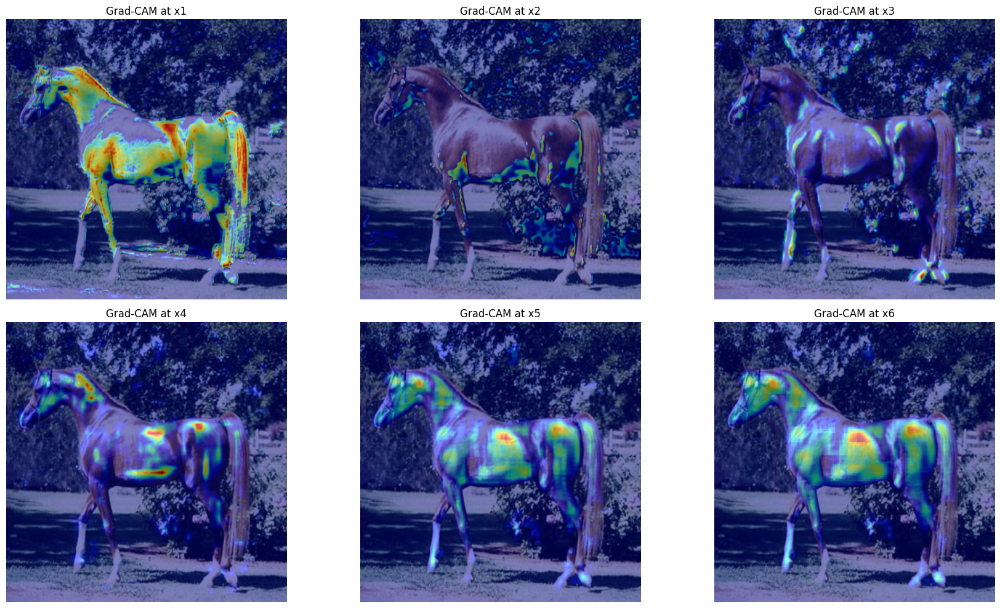


🔍 Running Seg-Grad-CAM on sample 3


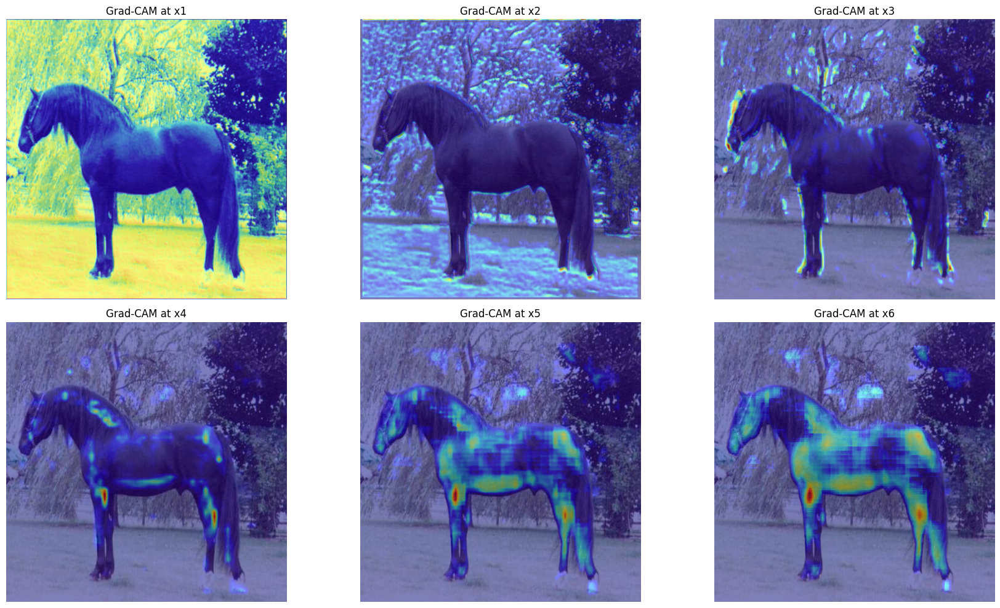


🔍 Running Seg-Grad-CAM on sample 4


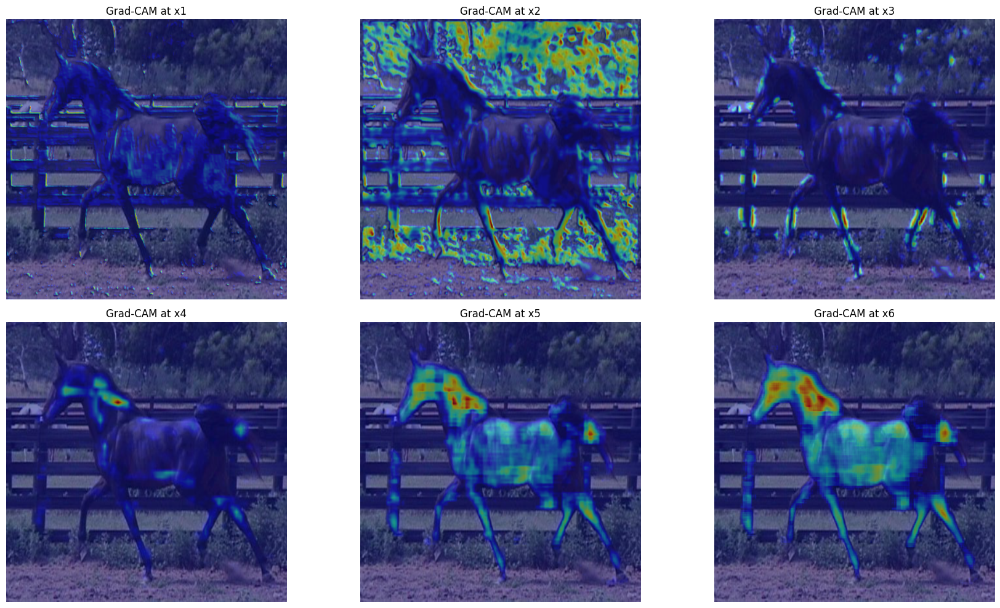


🔍 Running Seg-Grad-CAM on sample 5


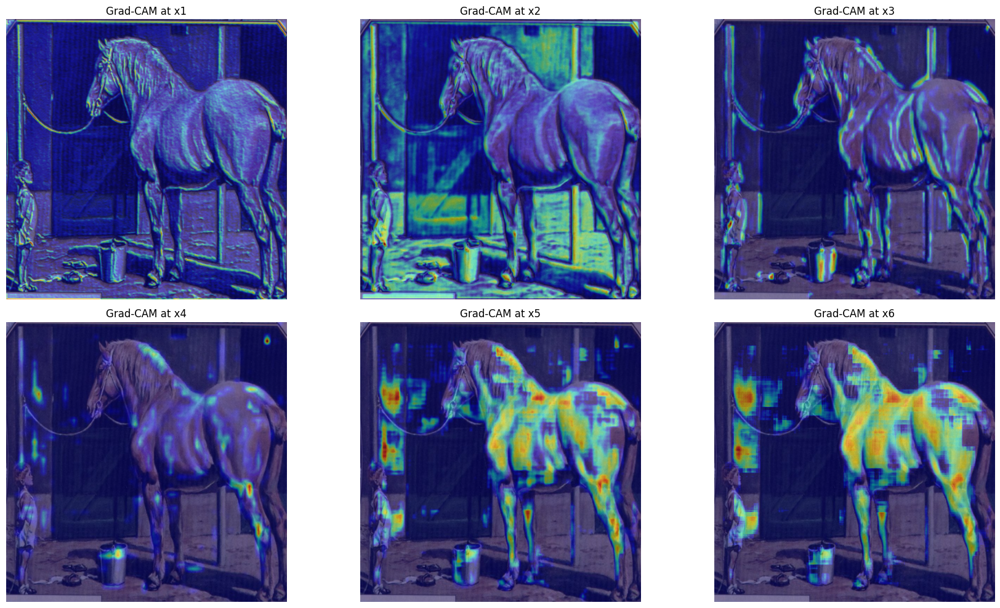

In [8]:
# ============ Seg-Grad-CAM Function ============
def seg_grad_cam(model, image_tensor, threshold=0.5):
    model.eval()
    image_tensor = image_tensor.unsqueeze(0).to(DEVICE).requires_grad_()

    mask_pred, x1, x2, x3, x4, x5, x6 = model(image_tensor)
    mask_pred = torch.sigmoid(mask_pred)
    mask = (mask_pred > threshold).float()

    feature_maps = [x1, x2, x3, x4, x5, x6]
    heatmaps = []

    for feat in feature_maps:
        model.zero_grad()
        feat.retain_grad()
        output_pixel_sum = (mask_pred * mask).sum()
        output_pixel_sum.backward(retain_graph=True)

        grad = feat.grad
        weights = grad.mean(dim=(2, 3), keepdim=True)
        cam = (weights * feat).sum(dim=1, keepdim=True)
        cam = F.relu(cam)

        cam = F.interpolate(cam, size=image_tensor.shape[2:], mode='bilinear', align_corners=False)
        cam = cam.squeeze().detach().cpu().numpy()
        cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
        heatmaps.append(cam)

    return mask_pred.squeeze().detach().cpu(), heatmaps

# ============ Visualization Function ============
def visualize_cam_on_image(image, cams, stage_names):
    image = image.permute(1, 2, 0).cpu().numpy()
    image = (image - image.min()) / (image.max() - image.min())

    plt.figure(figsize=(18, 10))
    for i, cam in enumerate(cams):
        plt.subplot(2, 3, i + 1)
        plt.imshow(image)
        plt.imshow(cam, cmap='jet', alpha=0.5)
        plt.title(f"Grad-CAM at {stage_names[i]}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# ============ Apply to 5 Random Validation Samples ============
stage_names = ['x1', 'x2', 'x3', 'x4', 'x5', 'x6']
model = UNet(in_channels=3, out_channels=1, k=200).to(DEVICE)
model.load_state_dict(torch.load("best_model.pth", map_location=DEVICE))

val_samples = random.sample(list(val_loader), 5)
for i, (img, _) in enumerate(val_samples):
    img = img[0]
    print(f"\n🔍 Running Seg-Grad-CAM on sample {i+1}")
    pred_mask, cams = seg_grad_cam(model, img)
    visualize_cam_on_image(img, cams, stage_names)
